# Amazon Fine Food Reviews Analysis


Data Source: https://www.kaggle.com/snap/amazon-fine-food-reviews <br>

EDA: https://nycdatascience.com/blog/student-works/amazon-fine-foods-visualization/


The Amazon Fine Food Reviews dataset consists of reviews of fine foods from Amazon.<br>

Number of reviews: 568,454<br>
Number of users: 256,059<br>
Number of products: 74,258<br>
Timespan: Oct 1999 - Oct 2012<br>
Number of Attributes/Columns in data: 10 

Attribute Information:

1. Id
2. ProductId - unique identifier for the product
3. UserId - unqiue identifier for the user
4. ProfileName
5. HelpfulnessNumerator - number of users who found the review helpful
6. HelpfulnessDenominator - number of users who indicated whether they found the review helpful or not
7. Score - rating between 1 and 5
8. Time - timestamp for the review
9. Summary - brief summary of the review
10. Text - text of the review


#### Objective:
Given a review, determine whether the review is positive (rating of 4 or 5) or negative (rating of 1 or 2).

<br>
[Q] How to determine if a review is positive or negative?<br>
<br> 
[Ans] We could use Score/Rating. A rating of 4 or 5 can be cosnidered as a positive review. A rating of 1 or 2 can be considered as negative one. A review of rating 3 is considered nuetral and such reviews are ignored from our analysis. This is an approximate and proxy way of determining the polarity (positivity/negativity) of a review.




# [1]. Reading Data

## [1.1] Loading the data

The dataset is available in two forms
1. .csv file
2. SQLite Database

In order to load the data, We have used the SQLITE dataset as it is easier to query the data and visualise the data efficiently.
<br> 

Here as we only want to get the global sentiment of the recommendations (positive or negative), we will purposefully ignore all Scores equal to 3. If the score is above 3, then the recommendation wil be set to "positive". Otherwise, it will be set to "negative".

In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")


import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

from tqdm import tqdm
import os

paramiko missing, opening SSH/SCP/SFTP paths will be disabled.  `pip install paramiko` to suppress


In [2]:
# using SQLite Table to read data.
con = sqlite3.connect('database.sqlite') 

# filtering only positive and negative reviews i.e. 
# not taking into consideration those reviews with Score=3
# SELECT * FROM Reviews WHERE Score != 3 LIMIT 500000, will give top 500000 data points
# you can change the number to any other number based on your computing power

# filtered_data = pd.read_sql_query(""" SELECT * FROM Reviews WHERE Score != 3 LIMIT 500000""", con) 
# for tsne assignment you can take 5k data points

filtered_data = pd.read_sql_query(""" SELECT * FROM Reviews WHERE Score != 3 LIMIT 5000""", con) 

# Give reviews with Score>3 a positive rating(1), and reviews with a score<3 a negative rating(0).
def partition(x):
    if x < 3:
        return 0
    return 1

#changing reviews with score less than 3 to be positive and vice-versa
actualScore = filtered_data['Score']
positiveNegative = actualScore.map(partition) 
filtered_data['Score'] = positiveNegative
print("Number of data points in our data", filtered_data.shape)
filtered_data.head(3)

Number of data points in our data (5000, 10)


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,1,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,0,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,1,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...


In [3]:
display = pd.read_sql_query("""
SELECT UserId, ProductId, ProfileName, Time, Score, Text, COUNT(*)
FROM Reviews
GROUP BY UserId
HAVING COUNT(*)>1
""", con)

In [4]:
print(display.shape)
display.head()

(80668, 7)


,UserId,ProductId,ProfileName,Time,Score,Text,COUNT(*)
0,#oc-R115TNMSPFT9I7,B007Y59HVM,Breyton,1331510400,2,Overall its just OK when considering the price...,2
1,#oc-R11D9D7SHXIJB9,B005HG9ET0,"Louis E. Emory ""hoppy""",1342396800,5,"My wife has recurring extreme muscle spasms, u...",3
2,#oc-R11DNU2NBKQ23Z,B007Y59HVM,Kim Cieszykowski,1348531200,1,This coffee is horrible and unfortunately not ...,2
3,#oc-R11O5J5ZVQE25C,B005HG9ET0,Penguin Chick,1346889600,5,This will be the bottle that you grab from the...,3
4,#oc-R12KPBODL2B5ZD,B007OSBE1U,Christopher P. Presta,1348617600,1,I didnt like this coffee. Instead of telling y...,2


In [5]:
display[display['UserId']=='AZY10LLTJ71NX']

,UserId,ProductId,ProfileName,Time,Score,Text,COUNT(*)
80638,AZY10LLTJ71NX,B006P7E5ZI,"undertheshrine ""undertheshrine""",1334707200,5,I was recommended to try green tea extract to ...,5


In [6]:
display['COUNT(*)'].sum()

393063

#  [2] Exploratory Data Analysis

## [2.1] Data Cleaning: Deduplication

It is observed (as shown in the table below) that the reviews data had many duplicate entries. Hence it was necessary to remove duplicates in order to get unbiased results for the analysis of the data.  Following is an example:

In [7]:
display= pd.read_sql_query("""
SELECT *
FROM Reviews
WHERE Score != 3 AND UserId="AR5J8UI46CURR"
ORDER BY ProductID
""", con)
display.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,78445,B000HDL1RQ,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
1,138317,B000HDOPYC,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
2,138277,B000HDOPYM,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
3,73791,B000HDOPZG,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
4,155049,B000PAQ75C,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...


As it can be seen above that same user has multiple reviews with same values for HelpfulnessNumerator, HelpfulnessDenominator, Score, Time, Summary and Text and on doing analysis it was found that <br>
<br> 
ProductId=B000HDOPZG was Loacker Quadratini Vanilla Wafer Cookies, 8.82-Ounce Packages (Pack of 8)<br>
<br> 
ProductId=B000HDL1RQ was Loacker Quadratini Lemon Wafer Cookies, 8.82-Ounce Packages (Pack of 8) and so on<br>

It was inferred after analysis that reviews with same parameters other than ProductId belonged to the same product just having different flavour or quantity. Hence in order to reduce redundancy it was decided to eliminate the rows having same parameters.<br>

The method used for the same was that we first sort the data according to ProductId and then just keep the first similar product review and delelte the others. for eg. in the above just the review for ProductId=B000HDL1RQ remains. This method ensures that there is only one representative for each product and deduplication without sorting would lead to possibility of different representatives still existing for the same product.

In [8]:
#Sorting data according to ProductId in ascending order
sorted_data=filtered_data.sort_values('ProductId', axis=0, ascending=True, inplace=False, kind='quicksort', na_position='last')

In [10]:
#Deduplication of entries
final=sorted_data.drop_duplicates(subset={"UserId","ProfileName","Time","Text"}, keep='first', inplace=False)
final.shape

(4986, 10)

In [11]:
#Checking to see how much % of data still remains
(final['Id'].size*1.0)/(filtered_data['Id'].size*1.0)*100

99.72

<b>Observation:-</b> It was also seen that in two rows given below the value of HelpfulnessNumerator is greater than HelpfulnessDenominator which is not practically possible hence these two rows too are removed from calcualtions

In [12]:
display= pd.read_sql_query("""
SELECT *
FROM Reviews
WHERE Score != 3 AND Id=44737 OR Id=64422
ORDER BY ProductID
""", con)

display.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,64422,B000MIDROQ,A161DK06JJMCYF,"J. E. Stephens ""Jeanne""",3,1,5,1224892800,Bought This for My Son at College,My son loves spaghetti so I didn't hesitate or...
1,44737,B001EQ55RW,A2V0I904FH7ABY,Ram,3,2,4,1212883200,Pure cocoa taste with crunchy almonds inside,It was almost a 'love at first bite' - the per...


In [13]:
final=final[final.HelpfulnessNumerator<=final.HelpfulnessDenominator]

In [14]:
#Before starting the next phase of preprocessing lets see the number of entries left
print(final.shape)

#How many positive and negative reviews are present in our dataset?
final['Score'].value_counts()

(4986, 10)


1    4178
0     808
Name: Score, dtype: int64

#  [3] Preprocessing

## [3.1].  Preprocessing Review Text

Now that we have finished deduplication our data requires some preprocessing before we go on further with analysis and making the prediction model.

Hence in the Preprocessing phase we do the following in the order below:-

1. Begin by removing the html tags
2. Remove any punctuations or limited set of special characters like , or . or # etc.
3. Check if the word is made up of english letters and is not alpha-numeric
4. Check to see if the length of the word is greater than 2 (as it was researched that there is no adjective in 2-letters)
5. Convert the word to lowercase
6. Remove Stopwords
7. Finally Snowball Stemming the word (it was obsereved to be better than Porter Stemming)<br>

After which we collect the words used to describe positive and negative reviews

In [15]:
from nltk.corpus import stopwords
stop = set(stopwords.words('english'))
words_to_keep = set(('not'))
stop -= words_to_keep
#initialising the snowball stemmer
sno = nltk.stem.SnowballStemmer('english')

 #function to clean the word of any html-tags
def cleanhtml(sentence):
    cleanr = re.compile('<.*?>')
    cleantext = re.sub(cleanr, ' ', sentence)
    return cleantext

#function to clean the word of any punctuation or special characters
def cleanpunc(sentence): 
    cleaned = re.sub(r'[?|!|\'|"|#]',r'',sentence)
    cleaned = re.sub(r'[.|,|)|(|\|/]',r' ',cleaned)
    return  cleaned

In [16]:
i=0
str1=' '
final_string=[]
all_positive_words=[] # store words from +ve reviews here
all_negative_words=[] # store words from -ve reviews here.
s=''
for sent in final['Text'].values:
    filtered_sentence=[]
    #print(sent);
    sent=cleanhtml(sent) # remove HTMl tags
    for w in sent.split():
        for cleaned_words in cleanpunc(w).split():
            if((cleaned_words.isalpha()) & (len(cleaned_words)>2)):    
                if(cleaned_words.lower() not in stop):
                    s=(sno.stem(cleaned_words.lower())).encode('utf8')
                    filtered_sentence.append(s)
                    if (final['Score'].values)[i] == 'positive': 
                        all_positive_words.append(s) #list of all words used to describe positive reviews
                    if(final['Score'].values)[i] == 'negative':
                        all_negative_words.append(s) #list of all words used to describe negative reviews reviews
                else:
                    continue
            else:
                continue 
    
    str1 = b" ".join(filtered_sentence) #final string of cleaned words
    
    
    final_string.append(str1)
    i+=1

In [17]:
final['CleanedText']=final_string  
final['CleanedText']=final['CleanedText'].str.decode("utf-8")
#below the processed review can be seen in the CleanedText Column 
print('Shape of final',final.shape)
final.head()

Shape of final (4986, 11)


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText
2546,2774,B00002NCJC,A196AJHU9EASJN,Alex Chaffee,0,0,1,1282953600,thirty bucks?,Why is this $[...] when the same product is av...,product avail www amazon com victor trap unrea...
2547,2775,B00002NCJC,A13RRPGE79XFFH,reader48,0,0,1,1281052800,Flies Begone,We have used the Victor fly bait for 3 seasons...,use victor fli bait season cant beat great pro...
1145,1244,B00002Z754,A3B8RCEI0FXFI6,B G Chase,10,10,1,962236800,WOW Make your own 'slickers' !,I just received my shipment and could hardly w...,receiv shipment could hard wait tri product lo...
1146,1245,B00002Z754,A29Z5PI9BW2PU3,Robbie,7,7,1,961718400,Great Product,This was a really good idea and the final prod...,realli good idea final product outstand use de...
2942,3204,B000084DVR,A1UGDJP1ZJWVPF,"T. Moore ""thoughtful reader""",1,1,1,1177977600,Good stuff!,I'm glad my 45lb cocker/standard poodle puppy ...,glad cocker standard poodl puppi love stuff tr...


In [18]:
preprocessed_reviews = final
type(preprocessed_reviews.shape)

tuple

<h2><font color='red'>[3.2] Preprocessing Review Summary</font></h2>

In [19]:
## Similartly you can do preprocessing for review summary also.

# [4] Featurization

## [4.1] BAG OF WORDS

In [20]:
# BoW on Text
print("**Bow Vectorizer**")
print("="*50)
count_vect = CountVectorizer(min_df = 100)
kmeans_bow = count_vect.fit_transform(preprocessed_reviews['CleanedText'])
print(kmeans_bow.shape)

**Bow Vectorizer**
(4986, 327)


## [4.2] Bi-Grams and n-Grams.

In [21]:
#bi-gram, tri-gram and n-gram

#removing stop words like "not" should be avoided before building n-grams
# count_vect = CountVectorizer(ngram_range=(1,2))
# please do read the CountVectorizer documentation http://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html

# you can choose these numebrs min_df=10, max_features=5000, of your choice
count_vect = CountVectorizer(ngram_range=(1,2), min_df=10, max_features=5000)
final_bigram_counts = count_vect.fit_transform(preprocessed_reviews['CleanedText'])
print("the type of count vectorizer ",type(final_bigram_counts))
print("the shape of out text BOW vectorizer ",final_bigram_counts.get_shape())
print("the number of unique words including both unigrams and bigrams ", final_bigram_counts.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text BOW vectorizer  (4986, 2906)
the number of unique words including both unigrams and bigrams  2906


## [4.3] TF-IDF

In [22]:
#TFIDF on Text
print("**TFIDF Vectorizer**")
print("="*50)
tf_idf_vect = TfidfVectorizer(min_df = 100)
kmeans_tfidf = tf_idf_vect.fit_transform(preprocessed_reviews['CleanedText'])
print(kmeans_tfidf.shape)

**TFIDF Vectorizer**
(4986, 327)


## [4.4] Word2Vec

In [23]:
import gensim
i=0
list_of_sent_kmeans=[]
for sent in tqdm(preprocessed_reviews['Text'].values):
    filtered_sentence=[]
    sent=cleanhtml(sent)
    for w in sent.split():
        for cleaned_words in cleanpunc(w).split():
            if(cleaned_words.isalpha()):    # checking is the word is alphabet
                filtered_sentence.append(cleaned_words.lower()) # appending to the list
            else:
                continue 
    list_of_sent_kmeans.append(filtered_sentence)

100%|████████████████████████████████████| 4986/4986 [00:00<00:00, 5051.79it/s]


In [25]:
w2v_model=gensim.models.Word2Vec(list_of_sent_kmeans,min_count=5,size=50, workers=6)
w2v_words = list(w2v_model.wv.vocab)
print(len(w2v_words))

E:\anaconda\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


3952


## [4.4.1] Converting text into vectors using Avg W2V, TFIDF-W2V

#### [4.4.1.1] Avg W2v

In [26]:
# average Word2Vec
# compute average word2vec for each review.
sent_vectors_kmeans = []; 
for sent in tqdm(list_of_sent_kmeans):
    sent_vec = np.zeros(50) 
    cnt_words =0; 
    for word in sent: # 
        if word in w2v_words:
            vec = w2v_model.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors_kmeans.append(sent_vec) 
print(len(sent_vectors_kmeans))
print(len(sent_vectors_kmeans[0]))

kmeans_w2vec_data = sent_vectors_kmeans

100%|█████████████████████████████████████| 4986/4986 [00:07<00:00, 693.65it/s]


4986
50


#### [4.4.1.2] TFIDF weighted W2v

In [27]:
tf_idf_vect = TfidfVectorizer(min_df = 100)
kmeans_tfidf = tf_idf_vect.fit_transform(preprocessed_reviews['CleanedText'])
dictionary = dict(zip(tf_idf_vect.get_feature_names(), list(tf_idf_vect.idf_)))
print(kmeans_tfidf.shape)

(4986, 327)


In [28]:
 #TF-IDF weighted Word2Vec
tfidf_feat = tf_idf_vect.get_feature_names() # tfidf words/col-names
# final_tf_idf is the sparse matrix with row= sentence, col=word and cell_val = tfidf

tfidf_sent_vectors_kmeans = []; # the tfidf-w2v for each sentence/review is stored in this list
row=0;
for sent in tqdm(list_of_sent_kmeans): # for each review/sentence 
    sent_vec = np.zeros(50) # as word vectors are of zero length
    weight_sum =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words and word in tfidf_feat:
            vec = w2v_model.wv[word]
#             tf_idf = tf_idf_matrix[row, tfidf_feat.index(word)]
            # to reduce the computation we are 
            # dictionary[word] = idf value of word in whole courpus
            # sent.count(word) = tf valeus of word in this review
            tf_idf = dictionary[word]*(sent.count(word)/len(sent))
            sent_vec += (vec * tf_idf)
            weight_sum += tf_idf
    if weight_sum != 0:
        sent_vec /= weight_sum
    tfidf_sent_vectors_kmeans.append(sent_vec)
    row += 1

100%|█████████████████████████████████████| 4986/4986 [00:07<00:00, 657.84it/s]


# [5] Assignment 10: K-Means, Agglomerative & DBSCAN Clustering

<ol>
    <li><strong>Apply K-means Clustering on these feature sets:</strong>
        <ul>
    <li><font color='red'>SET 1:</font>Review text, preprocessed one converted into vectors using (BOW)</li>
            <li><font color='red'>SET 2:</font>Review text, preprocessed one converted into vectors using (TFIDF)</li>
            <li><font color='red'>SET 3:</font>Review text, preprocessed one converted into vectors using (AVG W2v)</li>
            <li><font color='red'>SET 4:</font>Review text, preprocessed one converted into vectors using (TFIDF W2v)</li>
    <li>Find the best ‘k’ using the elbow-knee method (plot k vs inertia_)</li>
    <li>Once after you find the k clusters, plot the word cloud per each cluster so that at a single
go we can analyze the words in a cluster.</li>          
        </ul>
    </li>
    <br>
    <li><strong>Apply Agglomerative Clustering on these feature sets:</strong>
        <ul>
            <li><font color='red'>SET 3:</font>Review text, preprocessed one converted into vectors using (AVG W2v)</li>
            <li><font color='red'>SET 4:</font>Review text, preprocessed one converted into vectors using (TFIDF W2v)</li>
    <li>Apply agglomerative algorithm and try a different number of clusters like 2,5 etc.</li>
    <li>Same as that of K-means, plot word clouds for each cluster and summarize in your own words what that cluster is representing.</li>
            <li>You can take around 5000 reviews or so(as this is very computationally expensive one)</li>
        </ul>
    </li>
    <br>
    <br>
    <li><strong>Apply DBSCAN Clustering on these feature sets:</strong>
        <ul>
            <li><font color='red'>SET 3:</font>Review text, preprocessed one converted into vectors using (AVG W2v)</li>
            <li><font color='red'>SET 4:</font>Review text, preprocessed one converted into vectors using (TFIDF W2v)</li>
    <li>Find the best ‘Eps’ using the <a href='https://stackoverflow.com/questions/12893492/choosing-eps-and-minpts-for-dbscan-r/48558030#48558030'>elbow-knee method.</a></li>
    <li>Same as before, plot word clouds for each cluster and summarize in your own words what that cluster is representing.</li>
            <li>You can take around 5000 reviews for this as well.</li>
        </ul>
    </li>
</ol>

## [5.1] K-Means Clustering

### [5.1.1] Applying K-Means Clustering on BOW,<font color='red'> SET 1</font>

In [29]:
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from wordcloud import WordCloud 

In [30]:
clusters = list(range(2, 50,5))
inertia = []
for i in tqdm(clusters):
    kmeans = KMeans(n_clusters=i, n_jobs=-1).fit(kmeans_bow)
    inertia.append(kmeans.inertia_)

100%|██████████████████████████████████████████| 10/10 [01:52<00:00, 12.31s/it]


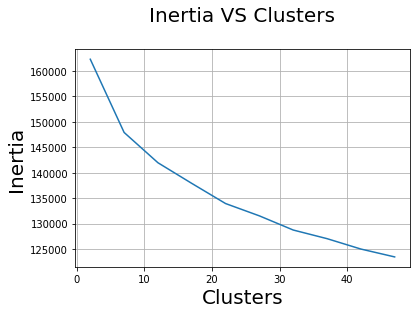

In [31]:
# Elbow Knee Method
plt.plot(clusters, inertia)
plt.xlabel('Clusters',size=20)
plt.ylabel('Inertia',size=20)
plt.title('Inertia VS Clusters\n',size=20)
plt.grid()
plt.show()

In [32]:
optimal_cluster = 7

In [33]:
kmeans = KMeans(n_clusters=optimal_cluster, n_jobs=-1).fit(kmeans_bow)

In [34]:
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = kmeans.labels_.shape[0]
cluster1 = []
cluster2 = []
cluster3 = []
cluster4 = []
cluster5 = []
cluster6 = []
cluster7 = []

In [35]:
for i in range(total_number_reviews):
    label = kmeans.labels_[i]
    if label == 0:
        cluster1.append(all_rev[i])
    elif label == 1:
        cluster2.append(all_rev[i])
    elif label == 2:
        cluster3.append(all_rev[i])
    elif label == 3:
        cluster4.append(all_rev[i])
    elif label == 4:
        cluster5.append(all_rev[i])
    elif label == 5:
        cluster6.append(all_rev[i])
    else :
        cluster7.append(all_rev[i]) 

In [38]:
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews in Cluster 2 : ",len(cluster2))
print("Total no. of reviews in Cluster 3 : ",len(cluster3))
print("Total no. of reviews in Cluster 4 : ",len(cluster4))
print("Total no. of reviews in Cluster 5 : ",len(cluster5))
print("Total no. of reviews in Cluster 6 : ",len(cluster6))


Total no. of reviews in Cluster 1 :  420
Total no. of reviews in Cluster 2 :  309
Total no. of reviews in Cluster 3 :  136
Total no. of reviews in Cluster 4 :  139
Total no. of reviews in Cluster 5 :  10
Total no. of reviews in Cluster 6 :  146


### [5.1.2] Wordclouds of clusters obtained after applying k-means on BOW<font color='red'> SET 1</font>

In [37]:
## function which will return text which excludes noise
import re
def getallwords(st):
    return re.compile('\w+').findall(st)

In [36]:
## Funtion will take full review text input and show the word cloud of unique words present in it
def showWordCloud(l):
    str1 = ''.join(l)
    strings = getallwords(str1)
    
    # getting unique words from list of words so storing all words in python set
    c=set();
    for i in strings:
        c.add(i)
    l = len(c)  
    unique_words = []
    for i in range(l):
        unique_words.append(c.pop()) # unique_words will contains all unique words from list of words

    unique_string=(" ").join(unique_words)
    wordcloud = WordCloud(width = 1000, height = 600,background_color ='white').generate(unique_string)
    plt.figure(figsize = (25, 20), facecolor = None) 
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.savefig("your_file_name"+".png", bbox_inches='tight')
    plt.show()
    plt.close()

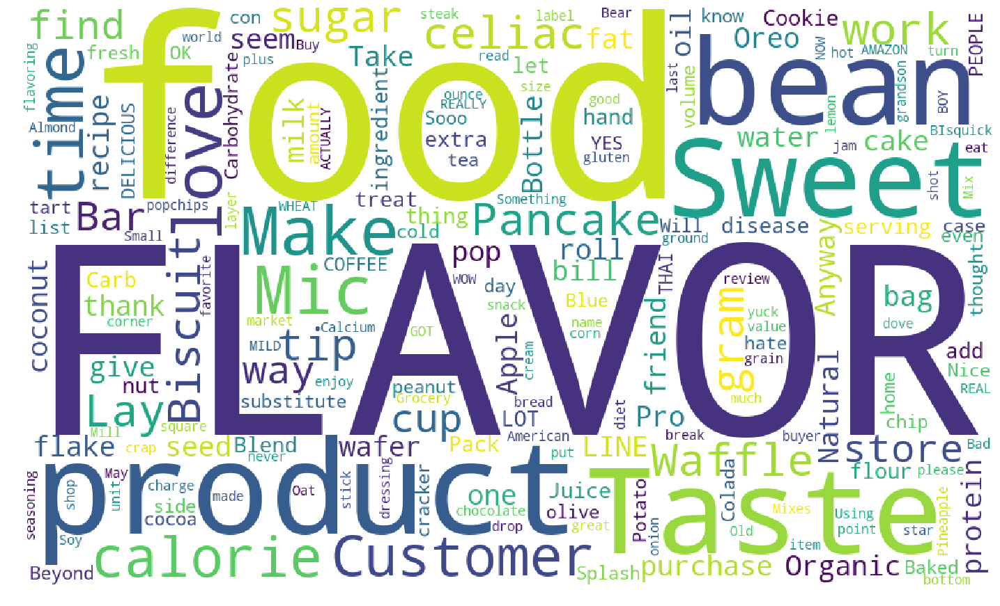

In [39]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "flavor", "food" and "sweet". This cluster seems to be related to sweet food items or deserts.

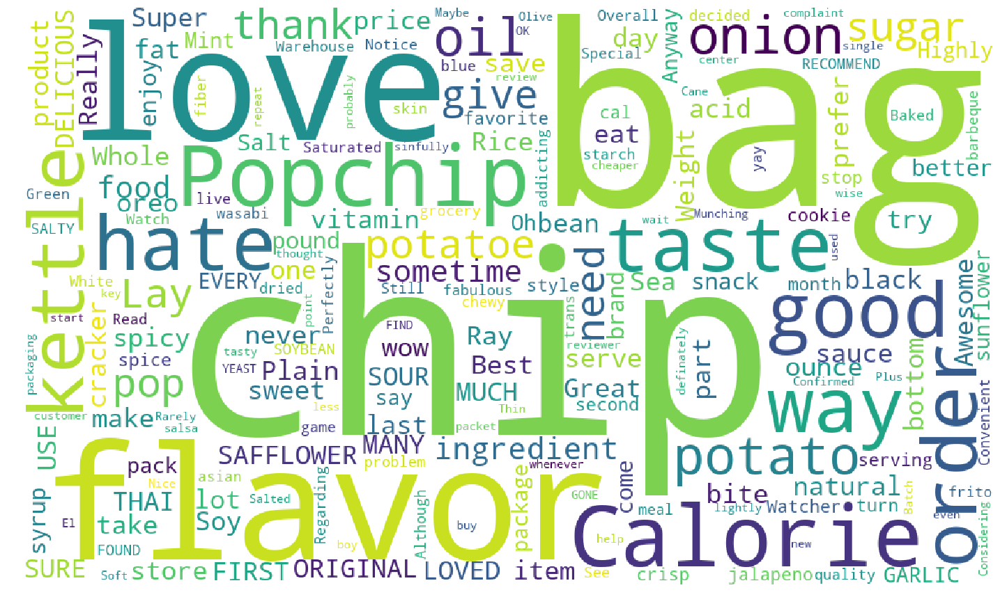

In [40]:
showWordCloud(cluster2)


The most frequently occuring word here seems to be "chip", "bag" and "flavor". This cluster seems to be related to potato chips.

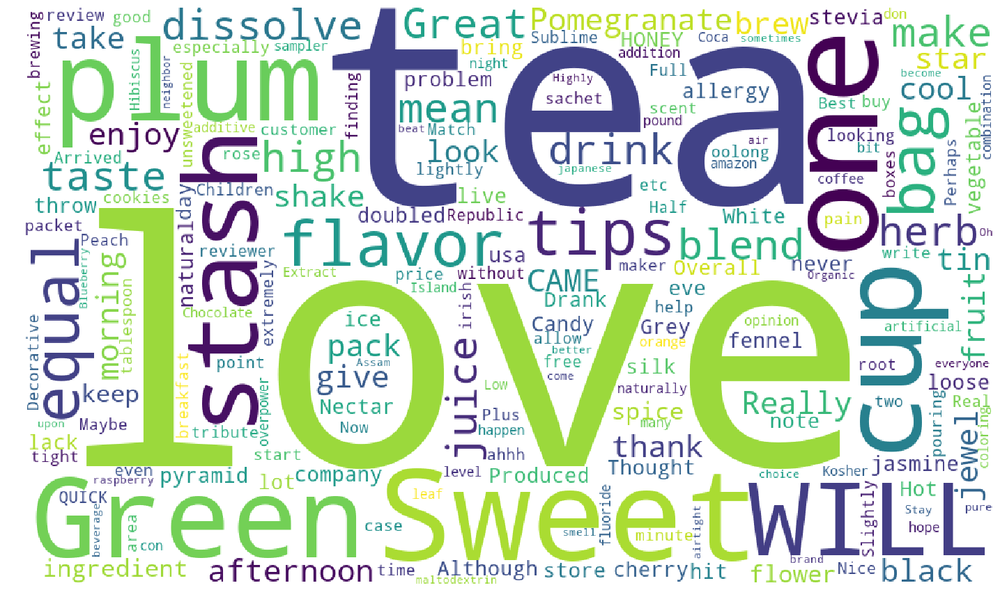

In [41]:
showWordCloud(cluster3)


The most frequently occuring word here seems to be "love", "tea" and "green". This cluster seems to be related to beverages.

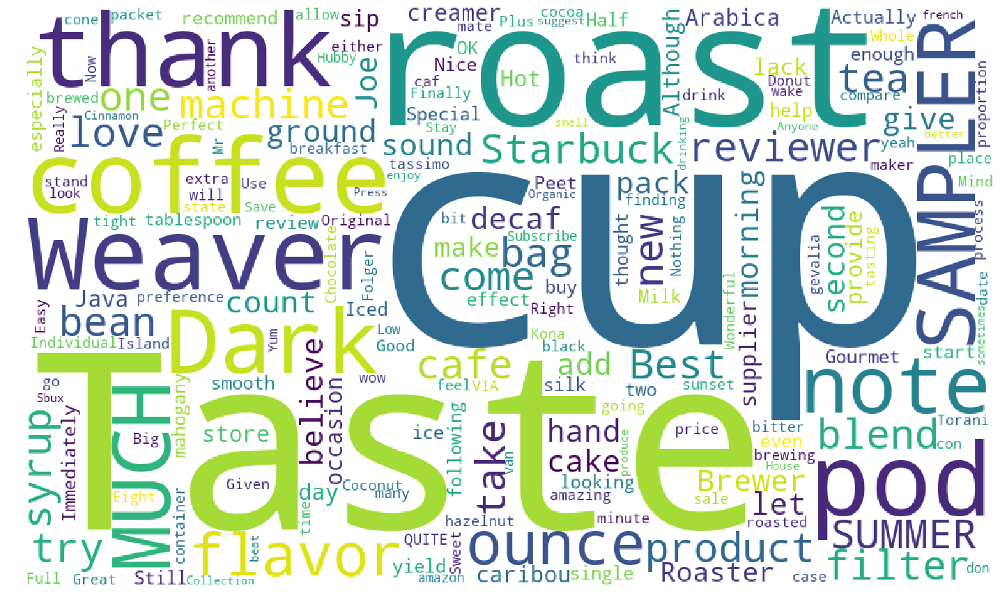

In [42]:
showWordCloud(cluster4)


The most frequently occuring word here seems to be "cup", "taste" and "roast". This cluster seems to be related to coffee.

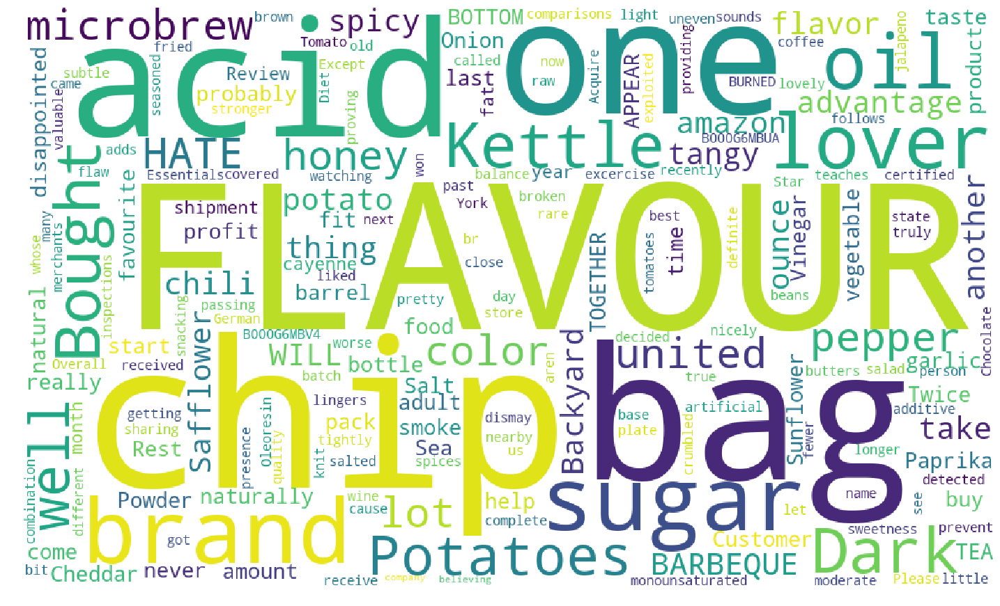

In [43]:
showWordCloud(cluster5)


The most frequently occuring word here seems to be "flavor", "chip" and "acid". This cluster seems to be related to potato chips.

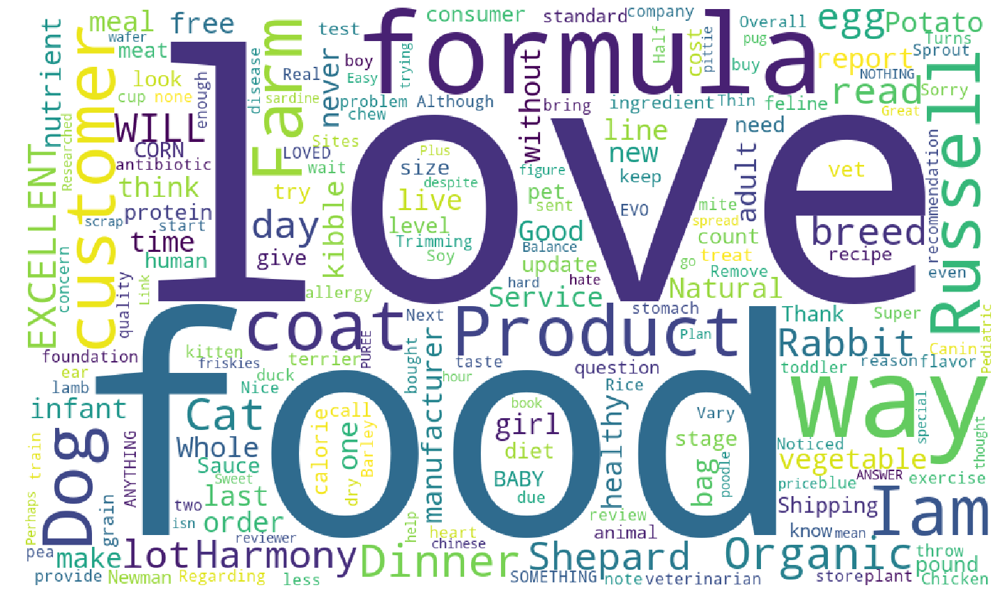

In [46]:
showWordCloud(cluster6)


The most frequently occuring word here seems to be "love", "food" and "formula". This cluster seems to be related to dog food products.

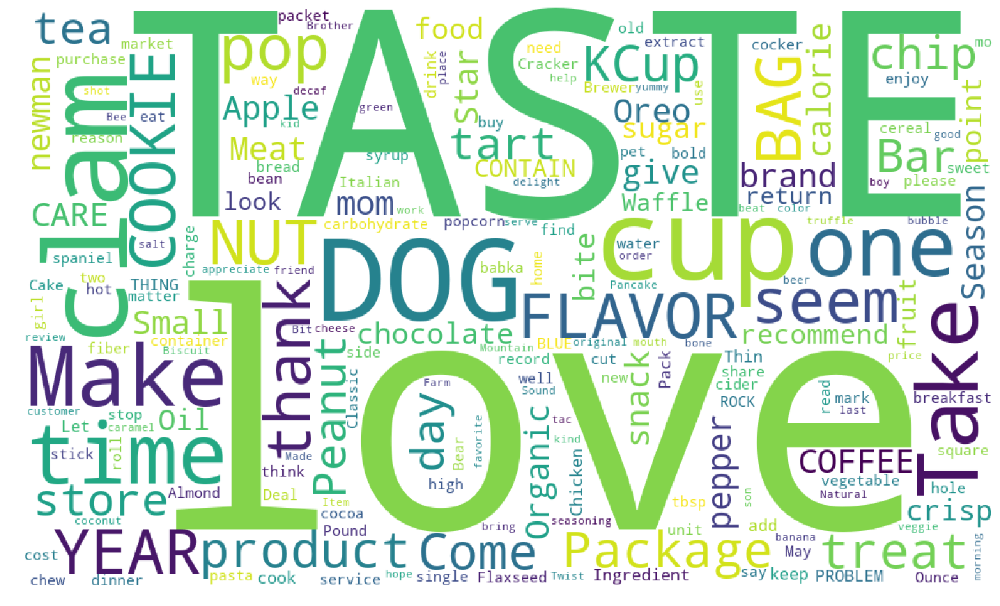

In [45]:
showWordCloud(cluster7)


The most frequently occuring word here seems to be "love", "dog" and "love". This cluster seems to be related to sweet dog foods.

### [5.1.3] Applying K-Means Clustering on TFIDF,<font color='red'> SET 2</font>

In [44]:
clusters = list(range(2, 50,5))
inertia = []
for i in tqdm(clusters):
    kmeans = KMeans(n_clusters=i, n_init=5, n_jobs=-1).fit(kmeans_tfidf)
    inertia.append(kmeans.inertia_)

100%|██████████████████████████████████████████| 10/10 [01:05<00:00,  6.24s/it]


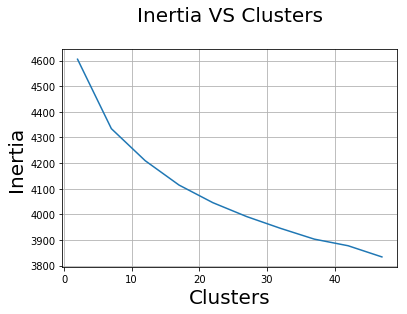

In [47]:
# Elbow Knee Method
plt.plot(clusters, inertia)
plt.xlabel('Clusters',size=20)
plt.ylabel('Inertia',size=20)
plt.title('Inertia VS Clusters\n',size=20)
plt.grid()
plt.show()

In [52]:
kmeans = KMeans(n_clusters=7, n_jobs=-1).fit(kmeans_tfidf)

In [51]:
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = kmeans.labels_.shape[0]
cluster1 = []
cluster2 = []
cluster3 = []
cluster4 = []
cluster5 = []
cluster6 = []

In [55]:
for i in range(total_number_reviews):
    label = kmeans.labels_[i]
    if label == 0:
        cluster1.append(all_rev[i])
    elif label == 1:
        cluster2.append(all_rev[i])
    elif label == 2:
        cluster3.append(all_rev[i])
    elif label == 3:
        cluster4.append(all_rev[i])
    elif label == 4:
        cluster5.append(all_rev[i])
    elif label == 5:
        cluster6.append(all_rev[i])
    else :
        cluster7.append(all_rev[i]) 

In [56]:
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews in Cluster 2 : ",len(cluster2))
print("Total no. of reviews in Cluster 3 : ",len(cluster3))
print("Total no. of reviews in Cluster 4 : ",len(cluster4))
print("Total no. of reviews in Cluster 5 : ",len(cluster5))
print("Total no. of reviews in Cluster 6 : ",len(cluster6))


Total no. of reviews in Cluster 1 :  2842
Total no. of reviews in Cluster 2 :  343
Total no. of reviews in Cluster 3 :  333
Total no. of reviews in Cluster 4 :  352
Total no. of reviews in Cluster 5 :  279
Total no. of reviews in Cluster 6 :  357


### [5.1.4] Wordclouds of clusters obtained after applying k-means on TFIDF<font color='red'> SET 2</font>

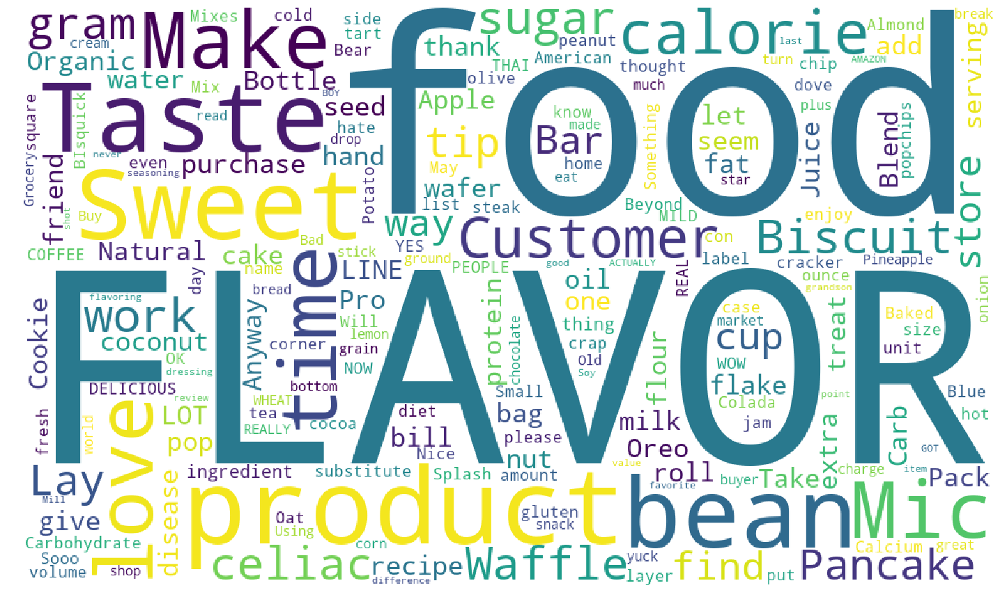

In [48]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "flavor", "food" and "sweet". This cluster seems to be related to sweet food items or deserts.

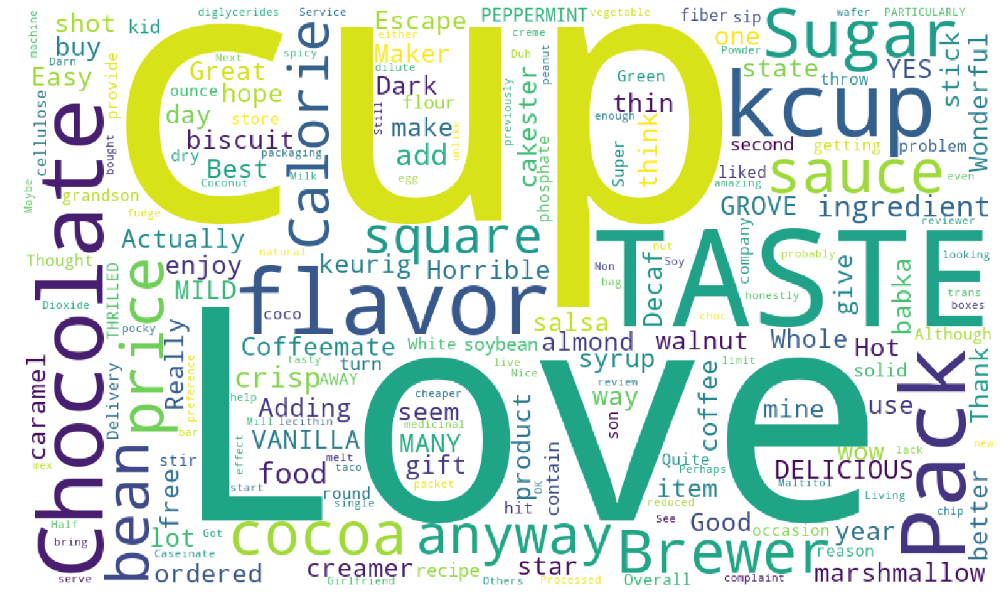

In [57]:
showWordCloud(cluster2)


The most frequently occuring word here seems to be "love", "cup" and "taste". This cluster seems to be related to hot chocolate or chiocolate beverages.

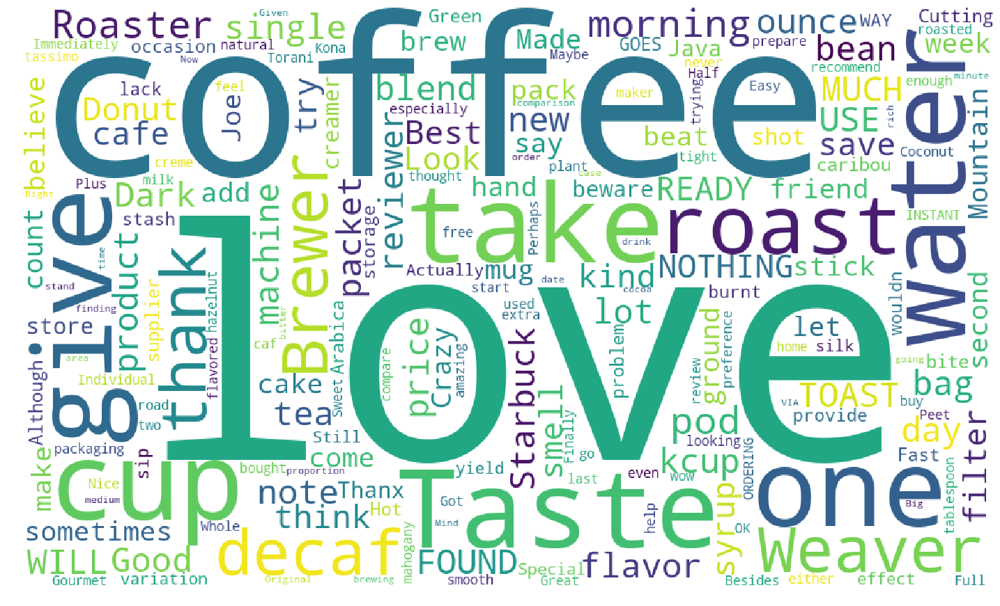

In [58]:
showWordCloud(cluster3)


The most frequently occuring word here seems to be "coffee", "love" and "taste". This cluster seems to be related to coffee.

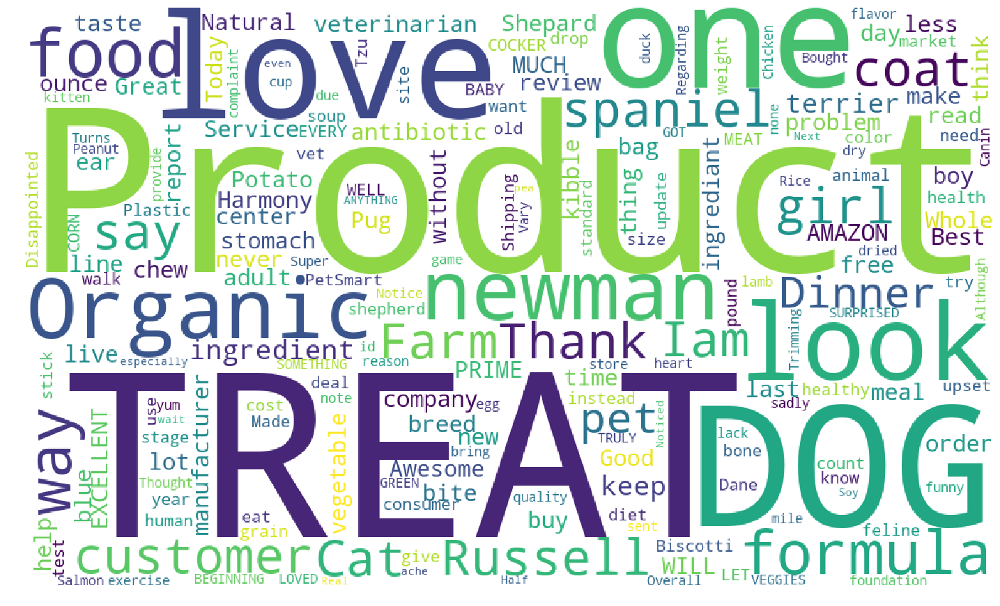

In [59]:
showWordCloud(cluster4)


The most frequently occuring word here seems to be "product", "treat" and "dog". This cluster seems to be related to dog food items.

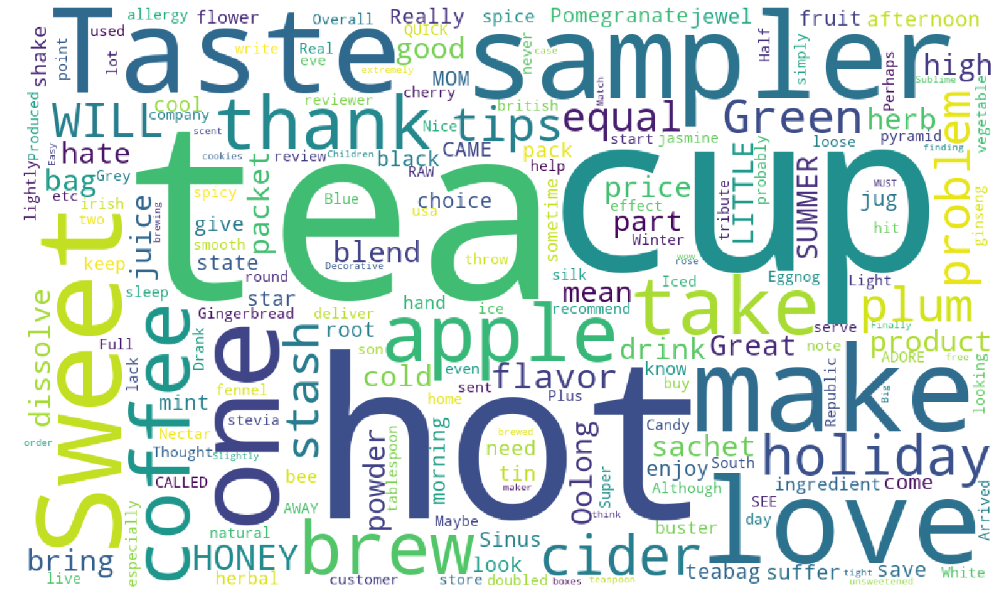

In [60]:
showWordCloud(cluster5)


The most frequently occuring word here seems to be "tea", "cup" and "hot". This cluster seems to be related to tea products.

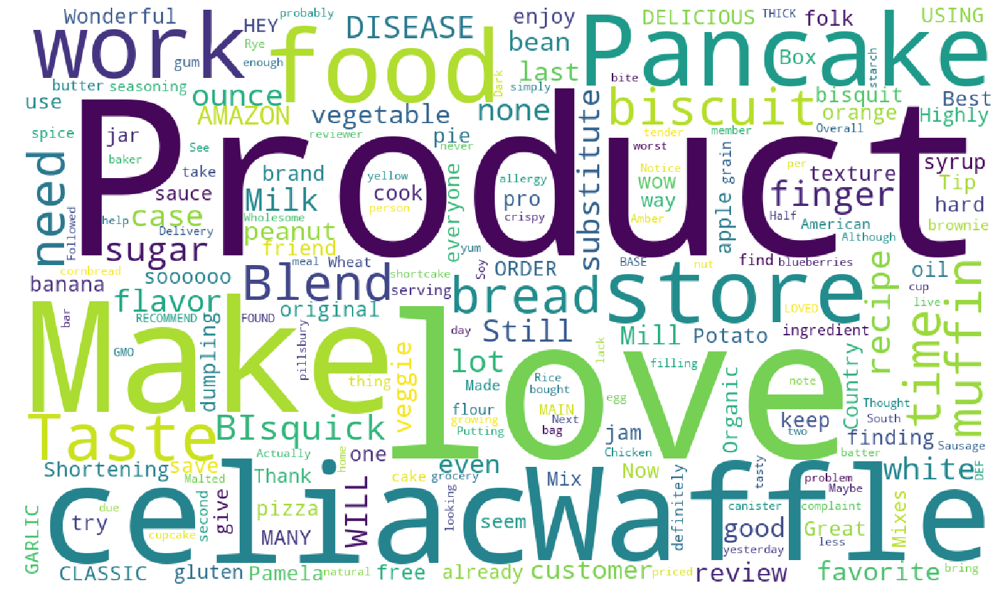

In [61]:
showWordCloud(cluster6)


The most frequently occuring word here seems to be "product", "love" and "waffle". This cluster seems to be related to pan cakes and waffles.

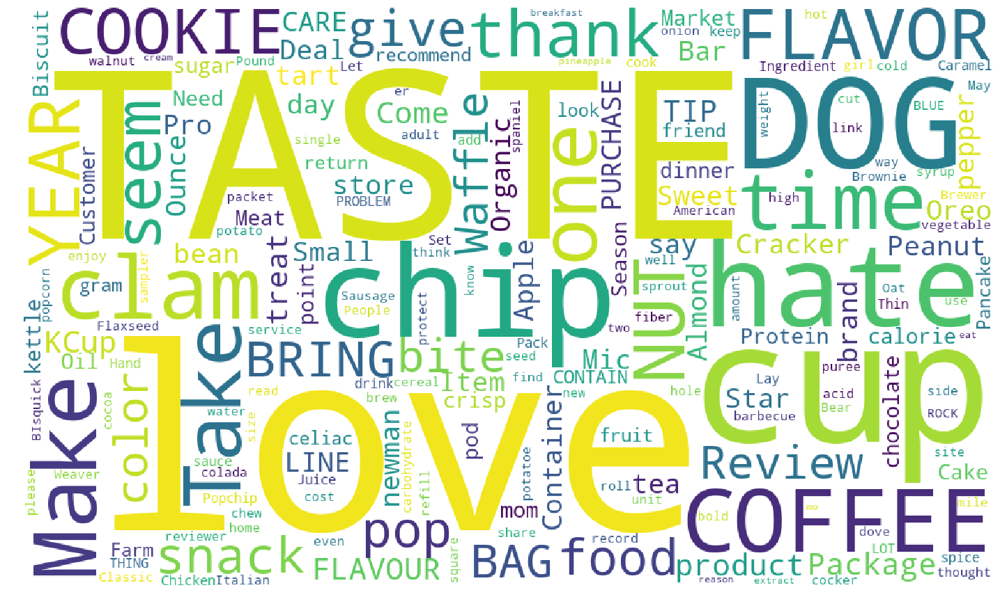

In [62]:
showWordCloud(cluster7)


The most frequently occuring word here seems to be "taste", "love" and "coffee". This cluster seems to be related to coffee.

### [5.1.5] Applying K-Means Clustering on AVG W2V,<font color='red'> SET 3</font>

In [66]:
# Please write all the code with proper documentation

In [147]:
clusters = list(range(2, 50,5))
inertia = []
for i in tqdm(clusters):
    kmeans = KMeans(n_clusters=i, n_init=5, n_jobs=-1).fit(kmeans_w2vec_data)
    inertia.append(kmeans.inertia_)

100%|██████████████████████████████████████████| 10/10 [00:09<00:00,  1.01it/s]


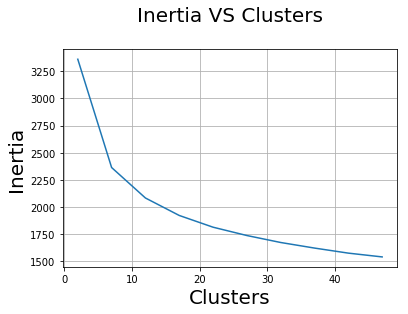

In [148]:
# Elbow Knee Method
plt.plot(clusters, inertia)
plt.xlabel('Clusters',size=20)
plt.ylabel('Inertia',size=20)
plt.title('Inertia VS Clusters\n',size=20)
plt.grid()
plt.show()

In [149]:
kmeans = KMeans(n_clusters=7, n_jobs=-1).fit(kmeans_w2vec_data)

In [150]:
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = kmeans.labels_.shape[0]
cluster1 = []
cluster2 = []
cluster3 = []
cluster4 = []
cluster5 = []
cluster6 = []
cluster7 = []

In [151]:
for i in range(total_number_reviews):
    label = kmeans.labels_[i]
    if label == 0:
        cluster1.append(all_rev[i])
    elif label == 1:
        cluster2.append(all_rev[i])
    elif label == 2:
        cluster3.append(all_rev[i])
    elif label == 3:
        cluster4.append(all_rev[i])
    elif label == 4:
        cluster5.append(all_rev[i])
    elif label == 5:
        cluster6.append(all_rev[i])
    else :
        cluster7.append(all_rev[i]) 

In [152]:
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews in Cluster 2 : ",len(cluster2))
print("Total no. of reviews in Cluster 3 : ",len(cluster3))
print("Total no. of reviews in Cluster 4 : ",len(cluster4))
print("Total no. of reviews in Cluster 5 : ",len(cluster5))
print("Total no. of reviews in Cluster 6 : ",len(cluster6))
print("Total no. of reviews in Cluster 7 : ",len(cluster7))



Total no. of reviews in Cluster 1 :  658
Total no. of reviews in Cluster 2 :  630
Total no. of reviews in Cluster 3 :  487
Total no. of reviews in Cluster 4 :  786
Total no. of reviews in Cluster 5 :  660
Total no. of reviews in Cluster 6 :  680
Total no. of reviews in Cluster 7 :  1085


### [5.1.6] Wordclouds of clusters obtained after applying k-means on AVG W2V<font color='red'> SET 3</font>

In [70]:
# Please write all the code with proper documentation

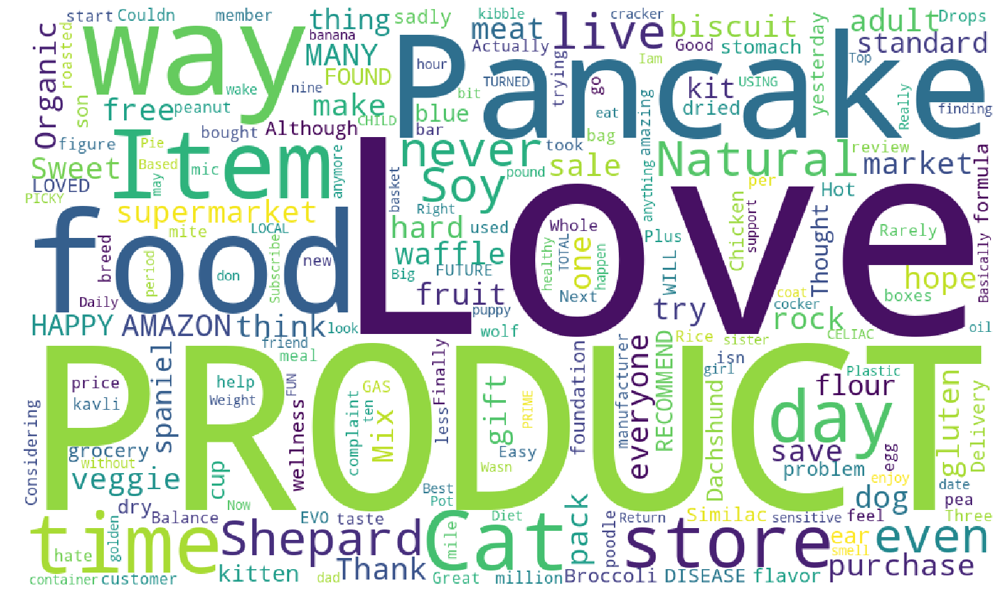

In [74]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "product", "love" and "panake". This cluster seems to be related to baked items.

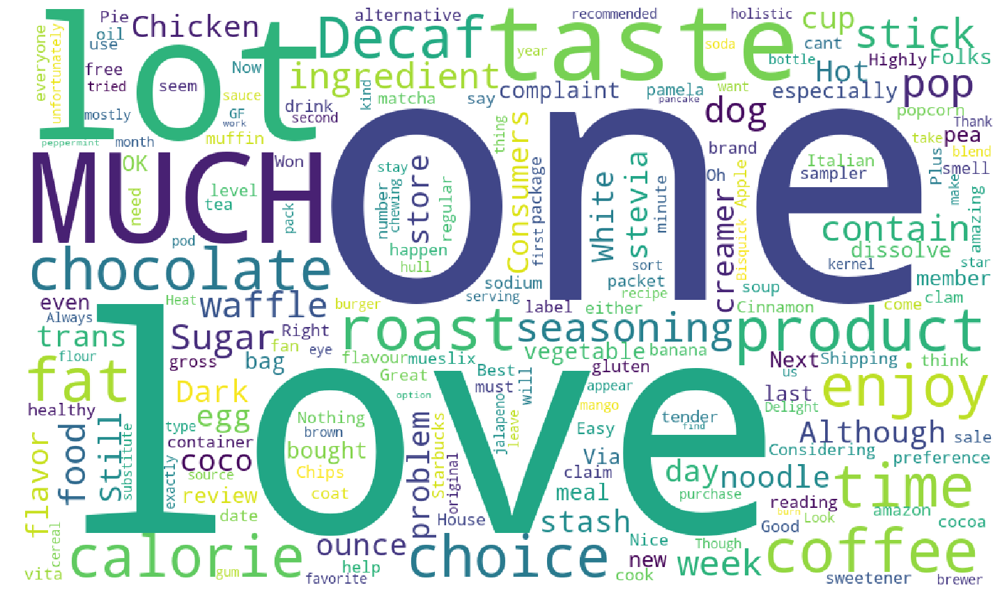

In [73]:
showWordCloud(cluster2)


The most frequently occuring word here seems to be "one", "love" and "lot". This cluster seems to be related to coffee.

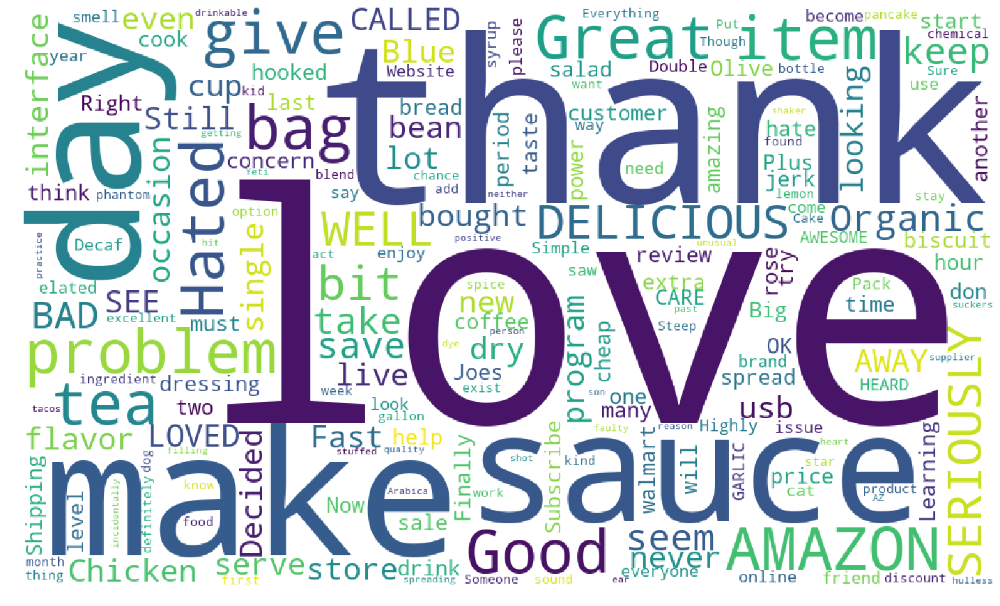

In [72]:
showWordCloud(cluster3)


The most frequently occuring word here seems to be "thank", "love" and "make". It is difficult to assign a category for this cluster clearly.

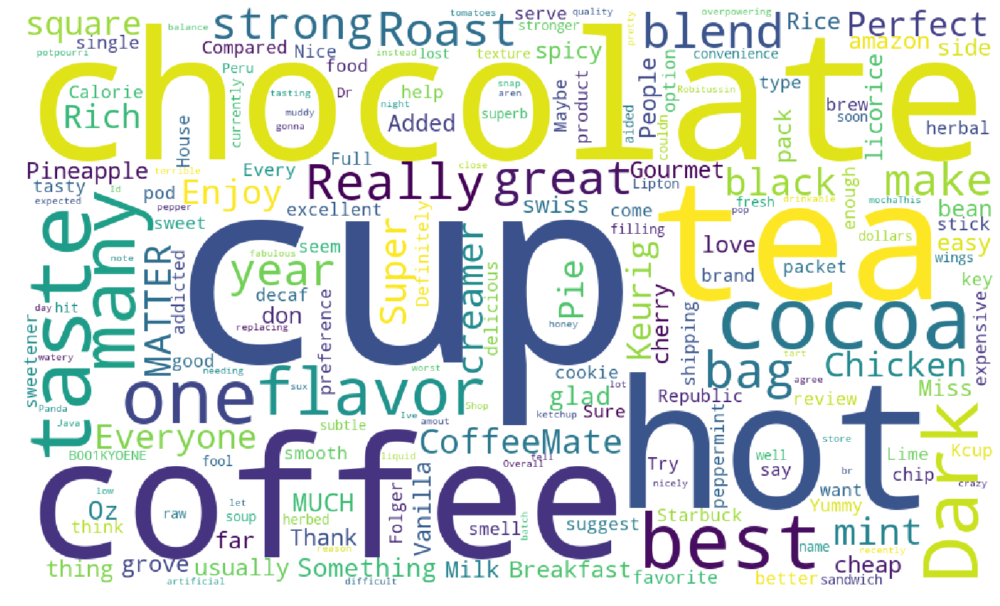

In [71]:
showWordCloud(cluster4)


The most frequently occuring word here seems to be "chocolate", "cup" and "cofee". This cluster seems to be related to hot beverages.

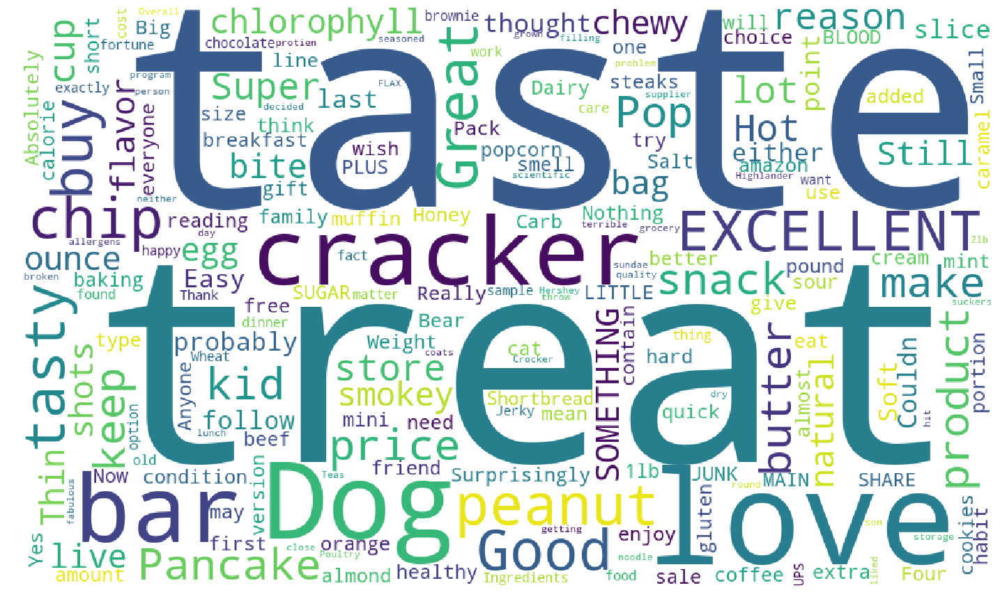

In [75]:
showWordCloud(cluster5)


The most frequently occuring word here seems to be "taste", "treat" and "cracker". This cluster seems to be related to dog food.

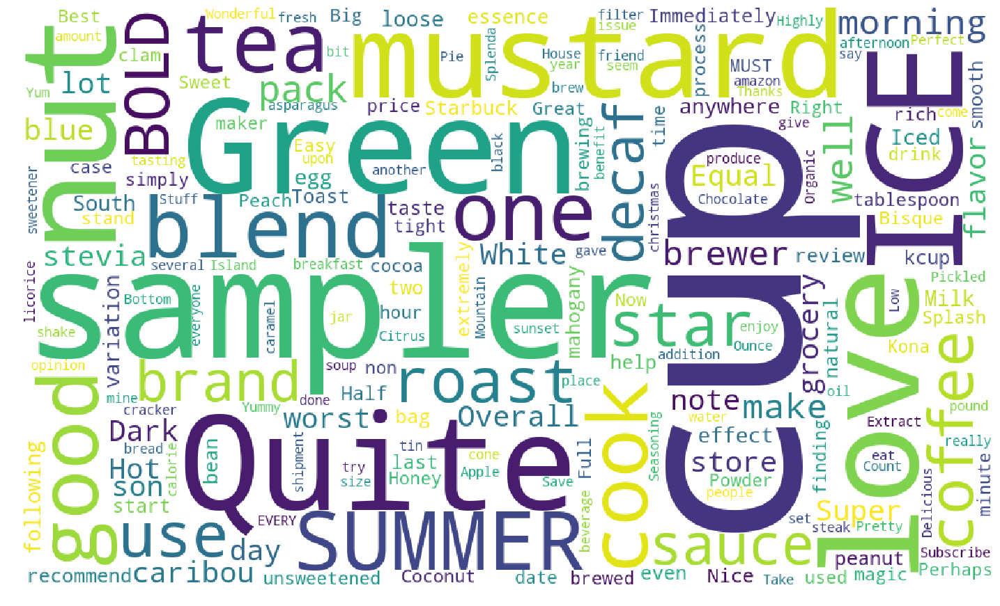

In [76]:
showWordCloud(cluster6)


The most frequently occuring word here seems to be "green", "sampler" and "cup". This cluster seems to be related to coffee.

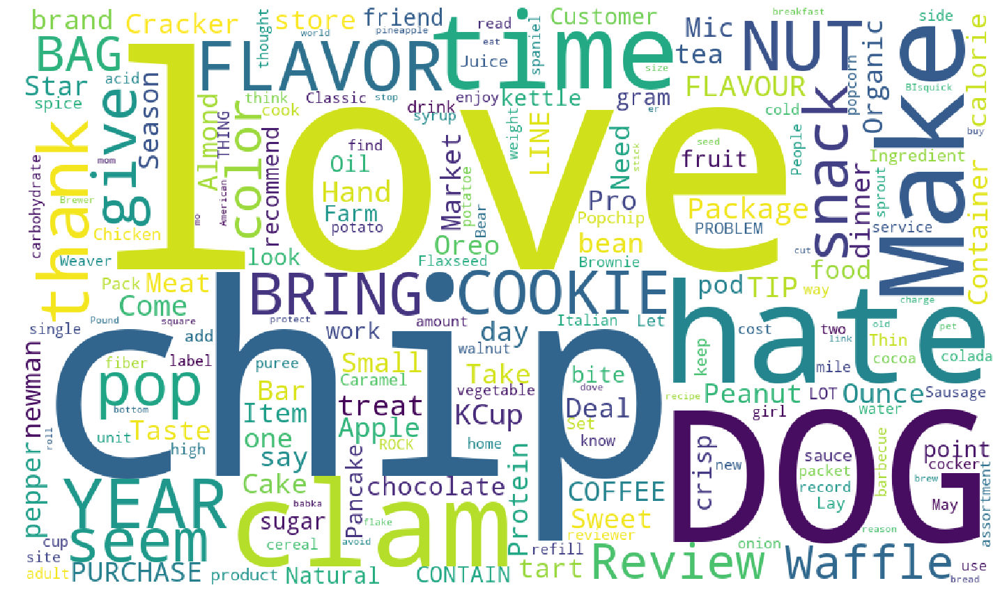

In [77]:
showWordCloud(cluster7)


The most frequently occuring word here seems to be "chip", "love" and "dog". This cluster seems to be related to dog food products.

### [5.1.7] Applying K-Means Clustering on TFIDF W2V,<font color='red'> SET 4</font>

In [78]:
# Please write all the code with proper documentation

In [79]:
clusters = list(range(2, 50,5))
inertia = []
for i in tqdm(clusters):
    kmeans = KMeans(n_clusters=i, n_jobs=-1).fit(tfidf_sent_vectors_kmeans)
    inertia.append(kmeans.inertia_)

100%|██████████████████████████████████████████| 10/10 [00:10<00:00,  1.51s/it]


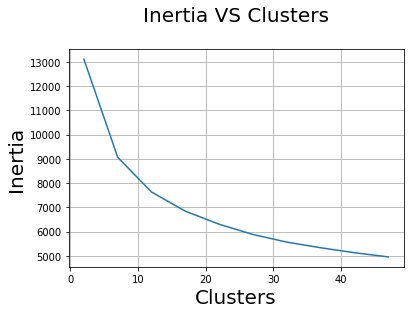

In [80]:
# Elbow Knee Method
plt.plot(clusters, inertia)
plt.xlabel('Clusters',size=20)
plt.ylabel('Inertia',size=20)
plt.title('Inertia VS Clusters\n',size=20)
plt.grid()
plt.show()

In [81]:
optimal_cluster = 7

In [82]:
kmeans = KMeans(n_clusters=optimal_cluster, n_jobs=-1).fit(tfidf_sent_vectors_kmeans)

In [83]:
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = kmeans.labels_.shape[0]
cluster1 = []
cluster2 = []
cluster3 = []
cluster4 = []
cluster5 = []
cluster6 = []
cluster7 = []

In [84]:
for i in range(total_number_reviews):
    label = kmeans.labels_[i]
    if label == 0:
        cluster1.append(all_rev[i])
    elif label == 1:
        cluster2.append(all_rev[i])
    elif label == 2:
        cluster3.append(all_rev[i])
    elif label == 3:
        cluster4.append(all_rev[i])
    elif label == 4:
        cluster5.append(all_rev[i])
    elif label == 5:
        cluster6.append(all_rev[i])
    else :
        cluster7.append(all_rev[i]) 

In [85]:
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews in Cluster 2 : ",len(cluster2))
print("Total no. of reviews in Cluster 3 : ",len(cluster3))
print("Total no. of reviews in Cluster 4 : ",len(cluster4))
print("Total no. of reviews in Cluster 5 : ",len(cluster5))
print("Total no. of reviews in Cluster 6 : ",len(cluster6))


Total no. of reviews in Cluster 1 :  513
Total no. of reviews in Cluster 2 :  269
Total no. of reviews in Cluster 3 :  1422
Total no. of reviews in Cluster 4 :  977
Total no. of reviews in Cluster 5 :  236
Total no. of reviews in Cluster 6 :  574


### [5.1.8] Wordclouds of clusters obtained after applying k-means on TFIDF W2V<font color='red'> SET 4</font>

In [87]:
# Please write all the code with proper documentation

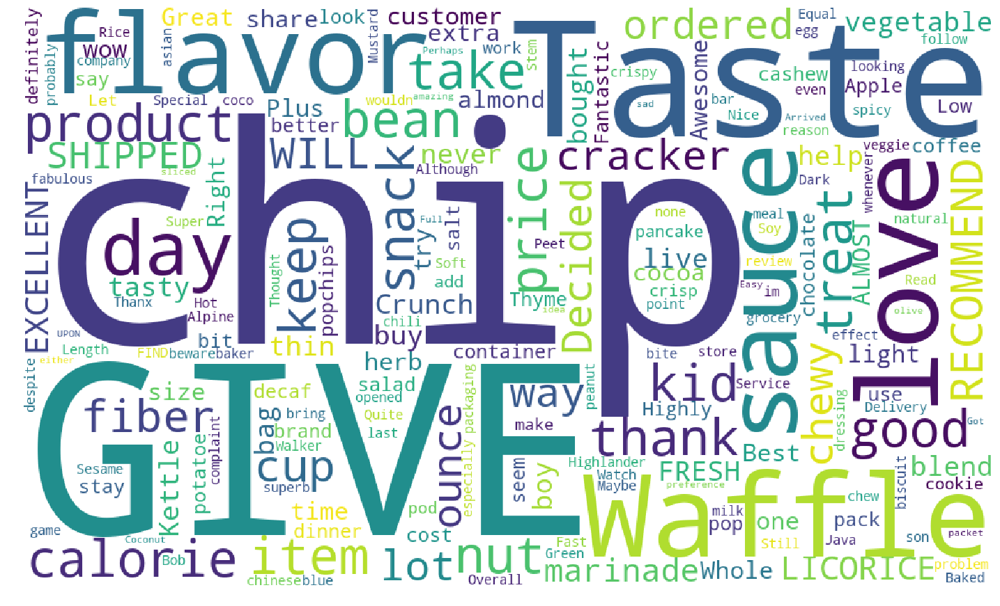

In [86]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "chip", "give" and "taste". This cluster seems to be related to baked/fried items.

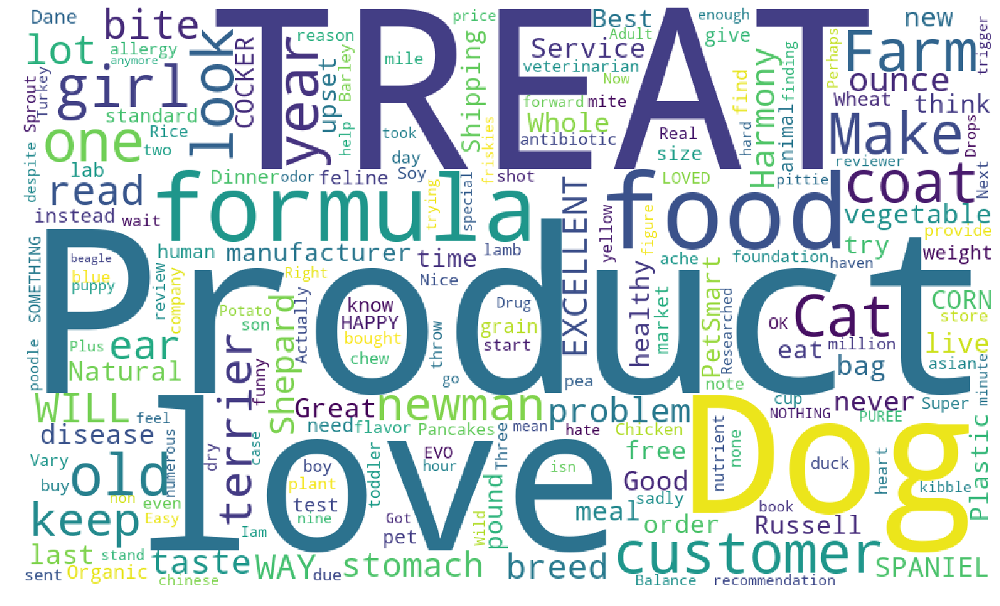

In [88]:
showWordCloud(cluster2)


The most frequently occuring word here seems to be "treat", "product" and "dog". This cluster seems to be related to dog food products.

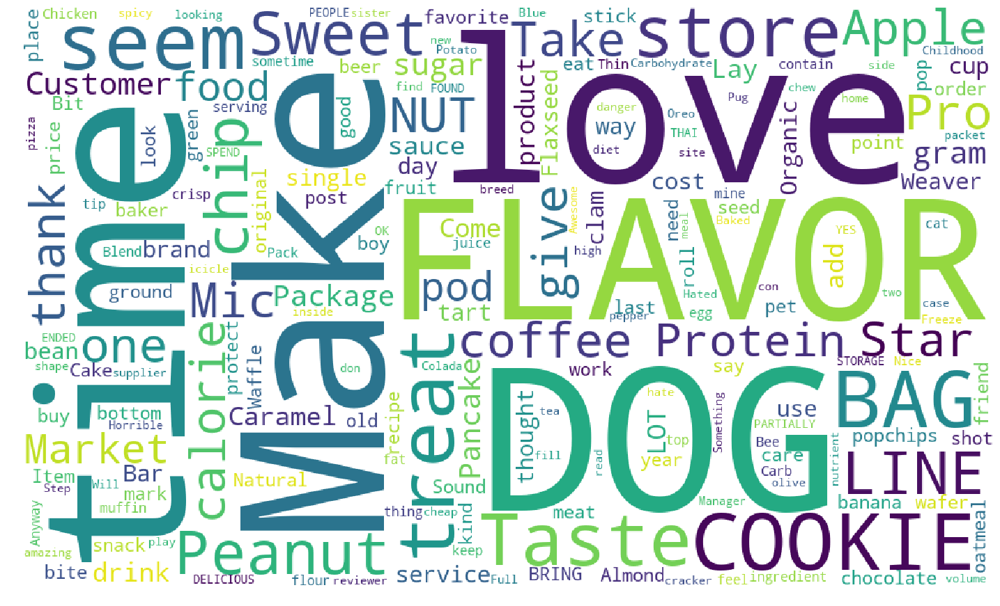

In [89]:
showWordCloud(cluster3)


The most frequently occuring word here seems to be "time", "flavour" and "dog". This cluster seems to have not clear segregation on the type of food.

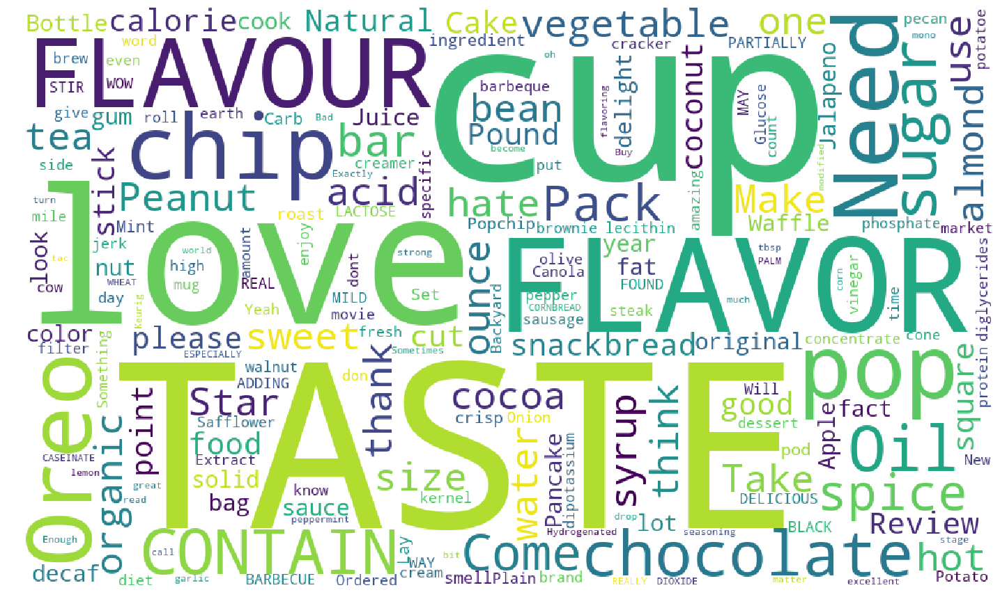

In [90]:
showWordCloud(cluster4)


The most frequently occuring word here seems to be "taste", "love" and "cup". This cluster seems to be related to chocolate beverages.

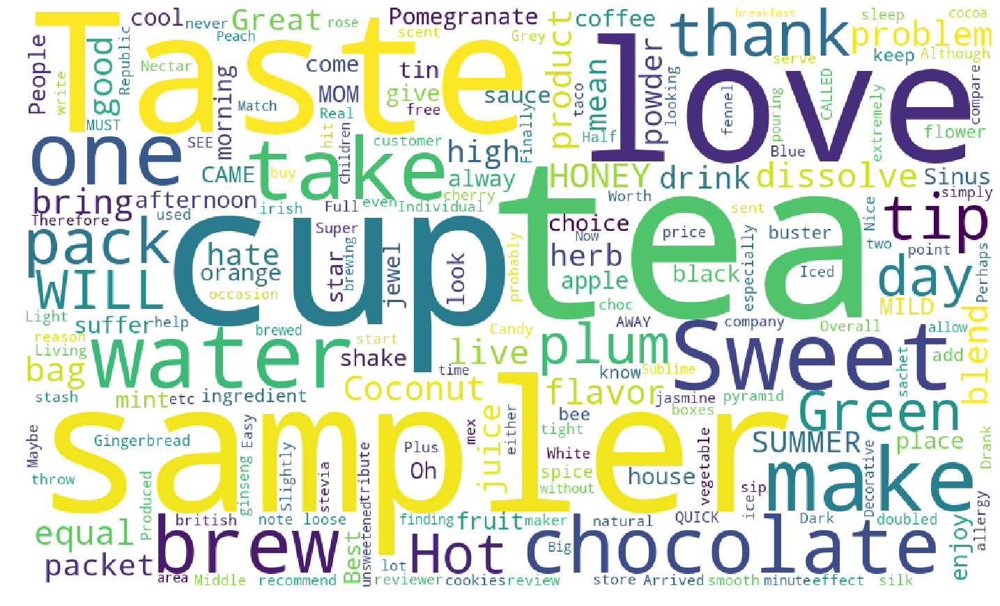

In [91]:
showWordCloud(cluster5)


The most frequently occuring word here seems to be "sampler", "taste" and "tea". This cluster seems to be related to hot beverages.

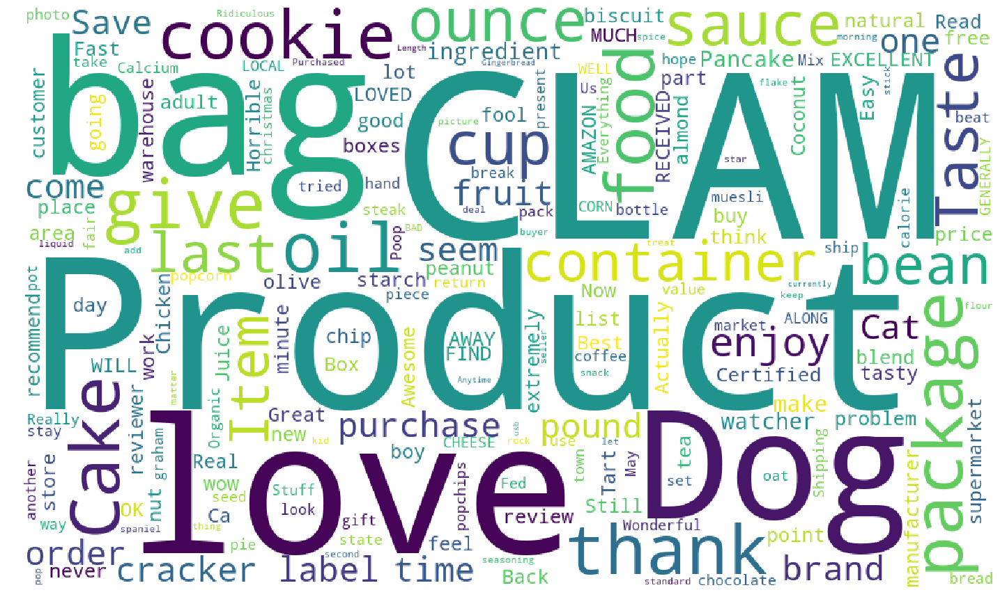

In [92]:
showWordCloud(cluster6)


The most frequently occuring word here seems to be "product", "clam" and "love". This cluster seems to be related to baked items.

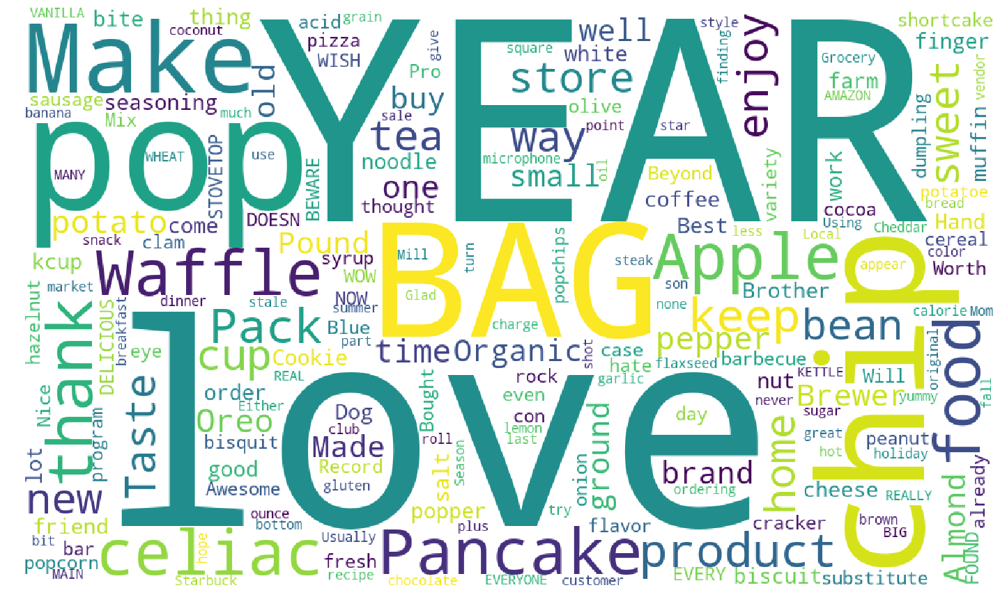

In [95]:
showWordCloud(cluster7)


The most frequently occuring word here seems to be "year", "bag" and "love". This cluster seems to be related to organic food items.

## [5.2] Agglomerative Clustering

### [5.2.1] Applying Agglomerative Clustering on AVG W2V,<font color='red'> SET 3</font>

In [94]:
# Please write all the code with proper documentation
#initiailizing with 2 clusters

agg_clust = AgglomerativeClustering(n_clusters = 2).fit(kmeans_w2vec_data)
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = agg_clust.labels_.shape[0]
cluster1 = []
cluster2 = []
for i in range(total_number_reviews):
    label = agg_clust.labels_[i]
    if label == 0:
        cluster1.append(all_rev[i])
    else :
        cluster2.append(all_rev[i]) 
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews in Cluster 2 : ",len(cluster2))

Total no. of reviews in Cluster 1 :  3401
Total no. of reviews in Cluster 2 :  1585


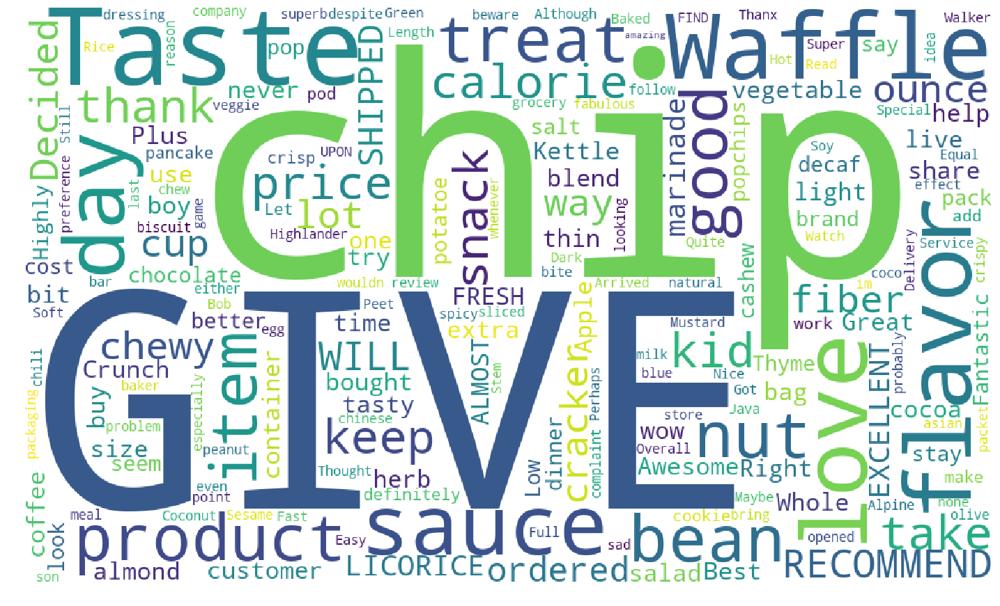

In [93]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "chip", "give" and "waffle". This cluster seems to be related to savoury/baked items.

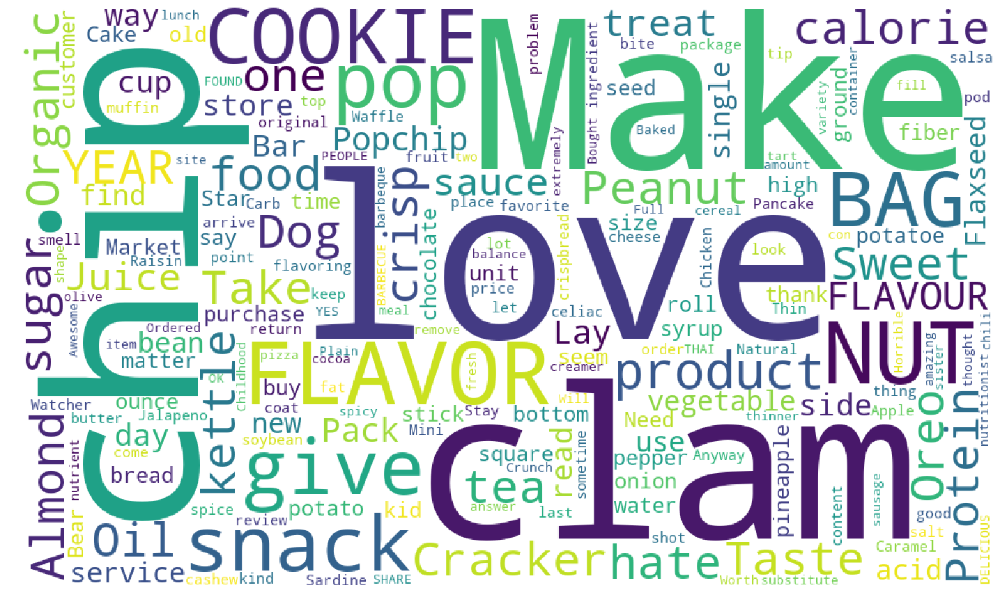

In [96]:
showWordCloud(cluster2)


The most frequently occuring word here seems to be "love", "chip" and "clam". This cluster seems to be related to sweet and seafood items products.

In [98]:
# Please write all the code with proper documentation
#initiailizing with 4 clusters

agg_clust = AgglomerativeClustering(n_clusters = 4).fit(kmeans_w2vec_data)
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = agg_clust.labels_.shape[0]
cluster1 = []
cluster2 = []
cluster3 = []
cluster4 = []
for i in range(total_number_reviews):
    label = agg_clust.labels_[i]
    if label == 0:
        cluster1.append(all_rev[i])
    elif label == 1:
        cluster2.append(all_rev[i])
    elif label == 2:
        cluster3.append(all_rev[i])
    else :
        cluster4.append(all_rev[i]) 
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews in Cluster 2 : ",len(cluster2))
print("Total no. of reviews in Cluster 3 : ",len(cluster3))
print("Total no. of reviews in Cluster 4 : ",len(cluster4))

Total no. of reviews in Cluster 1 :  2520
Total no. of reviews in Cluster 2 :  832
Total no. of reviews in Cluster 3 :  881
Total no. of reviews in Cluster 4 :  753


### [5.2.2] Wordclouds of clusters obtained after applying Agglomerative Clustering on AVG W2V<font color='red'> SET 3</font>

In [100]:
# Please write all the code with proper documentation

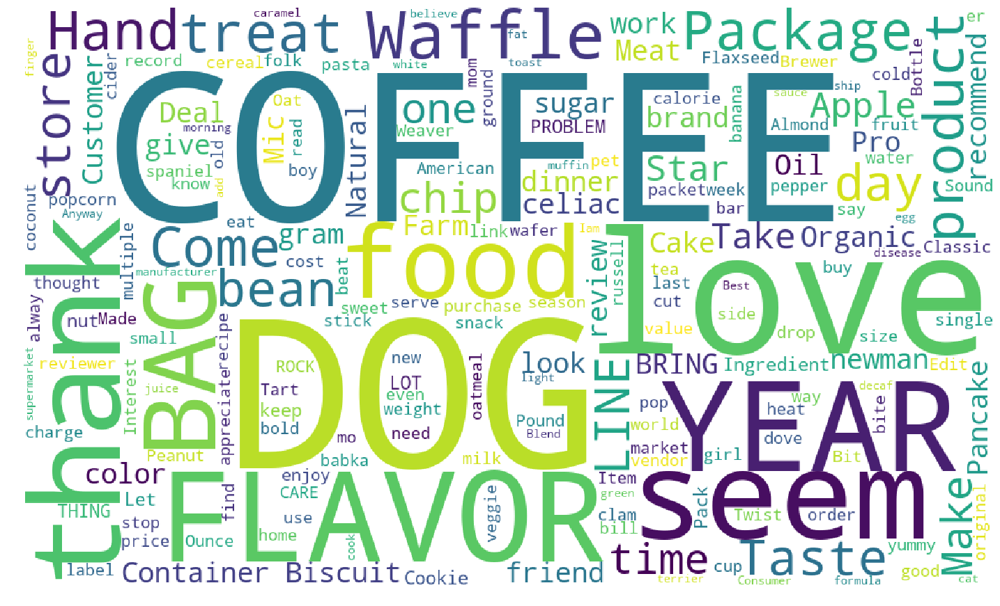

In [101]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "coffee", "dog" and "flavor". This cluster seems to be related to dog food products as well as coffee products.

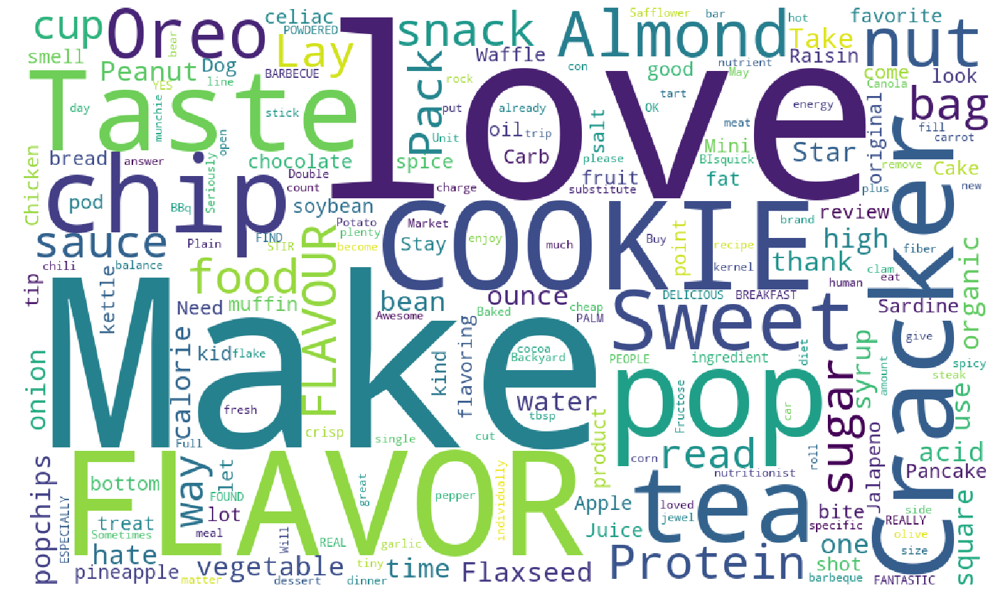

In [99]:
showWordCloud(cluster2)


The most frequently occuring word here seems to be "love", "make" and "flavour". This cluster seems to be related to sweet items and tea related products.

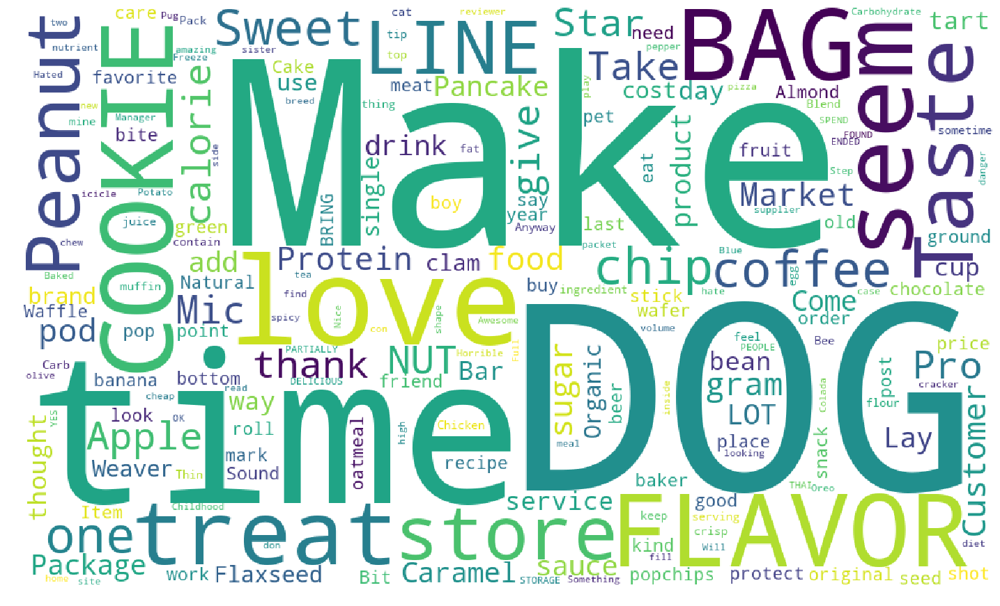

In [97]:
showWordCloud(cluster3)


The most frequently occuring word here seems to be "make", "time" and "dog". This cluster seems to be related to dog food products and sweet items

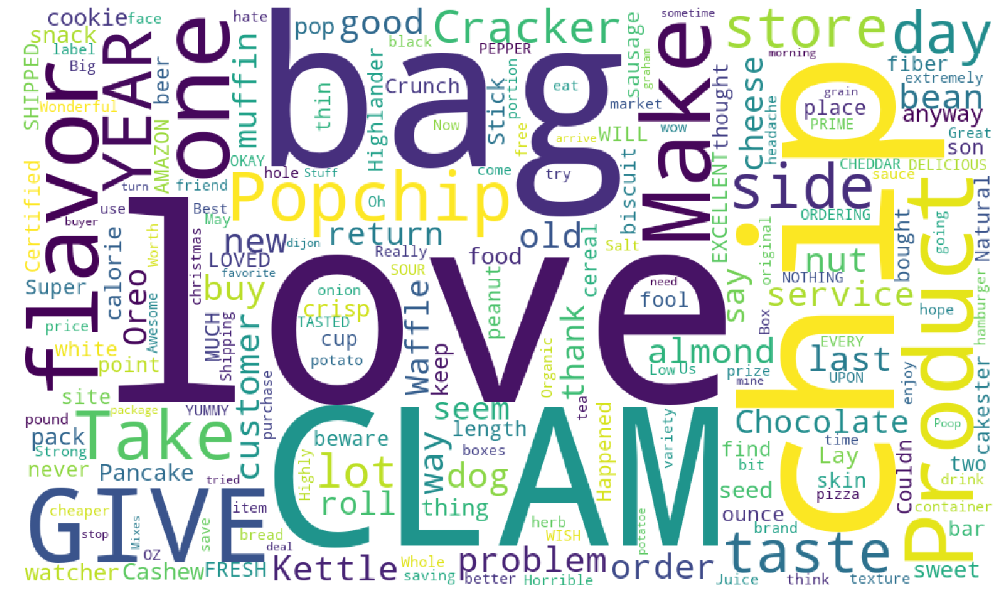

In [102]:
showWordCloud(cluster4)


The most frequently occuring word here seems to be "bag", "love" and "clam". This cluster seems to be related to chips and savoury items.

### [5.2.3] Applying Agglomerative Clustering on TFIDF W2V,<font color='red'> SET 4</font>

In [103]:
# Please write all the code with proper documentation

In [104]:
# Please write all the code with proper documentation
#initiailizing with 2 clusters

agg_clust = AgglomerativeClustering(n_clusters = 2).fit(tfidf_sent_vectors_kmeans)
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = agg_clust.labels_.shape[0]
cluster1 = []
cluster2 = []
for i in range(total_number_reviews):
    label = agg_clust.labels_[i]
    if label == 0:
        cluster1.append(all_rev[i])
    else :
        cluster2.append(all_rev[i]) 
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews in Cluster 2 : ",len(cluster2))

Total no. of reviews in Cluster 1 :  3579
Total no. of reviews in Cluster 2 :  1407


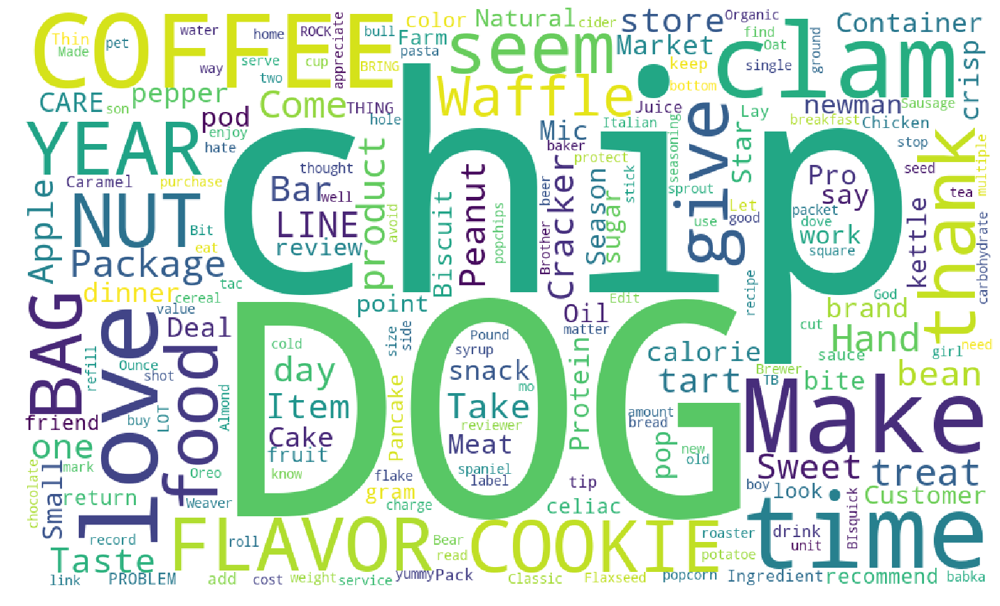

In [105]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "chip", "coffee" and "dog". This cluster seems to be related to dog food, chips, and beverages.

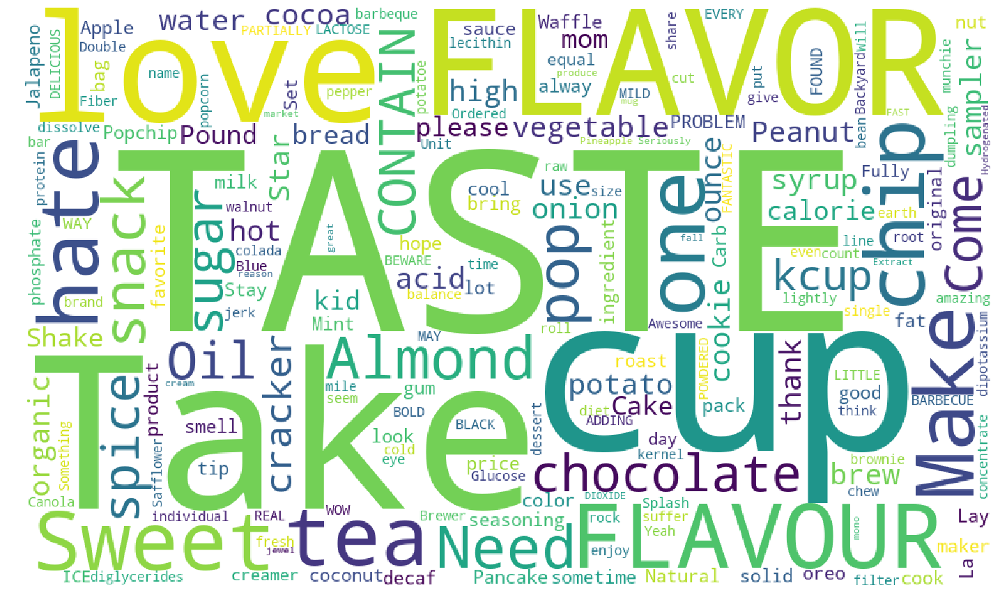

In [106]:
showWordCloud(cluster2)


The most frequently occuring word here seems to be "taste", "flavour" and "cup". This cluster seems to be related to hot beverages, snacks and sweets.

In [107]:
# Please write all the code with proper documentation
#initiailizing with 4 clusters

agg_clust = AgglomerativeClustering(n_clusters = 4).fit(tfidf_sent_vectors_kmeans)
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = agg_clust.labels_.shape[0]
cluster1 = []
cluster2 = []
cluster3 = []
cluster4 = []
for i in range(total_number_reviews):
    label = agg_clust.labels_[i]
    if label == 0:
        cluster1.append(all_rev[i])
    elif label == 1:
        cluster2.append(all_rev[i])
    elif label == 2:
        cluster3.append(all_rev[i])
    else :
        cluster4.append(all_rev[i]) 
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews in Cluster 2 : ",len(cluster2))
print("Total no. of reviews in Cluster 3 : ",len(cluster3))
print("Total no. of reviews in Cluster 4 : ",len(cluster4))

Total no. of reviews in Cluster 1 :  1364
Total no. of reviews in Cluster 2 :  1170
Total no. of reviews in Cluster 3 :  2215
Total no. of reviews in Cluster 4 :  237


### [5.2.4] Wordclouds of clusters obtained after applying Agglomerative Clustering on TFIDF W2V<font color='red'> SET 4</font>

In [108]:
# Please write all the code with proper documentation

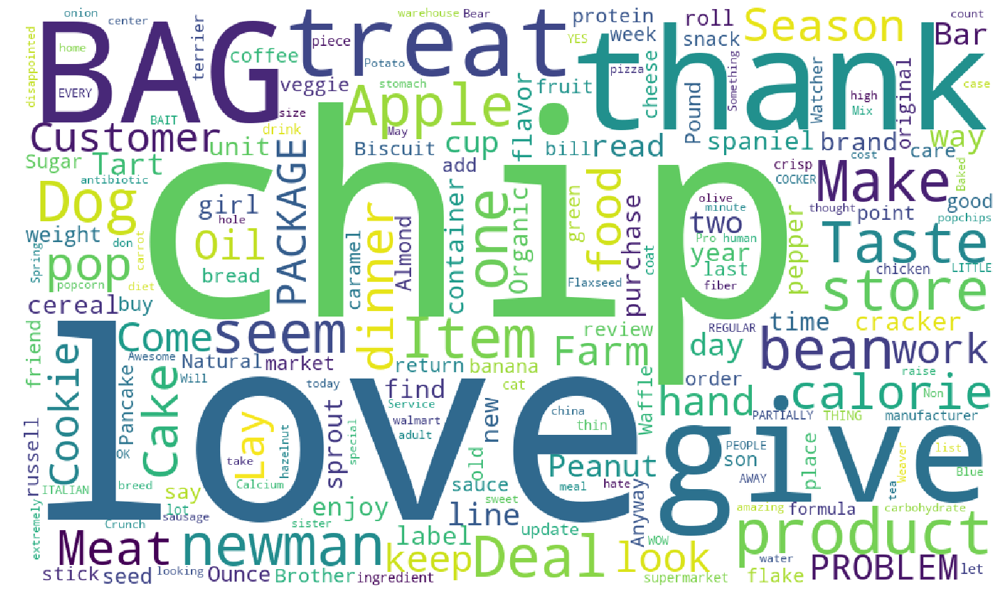

In [109]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "chip", "love" and "bag". This cluster seems to be related to savoury snacks.

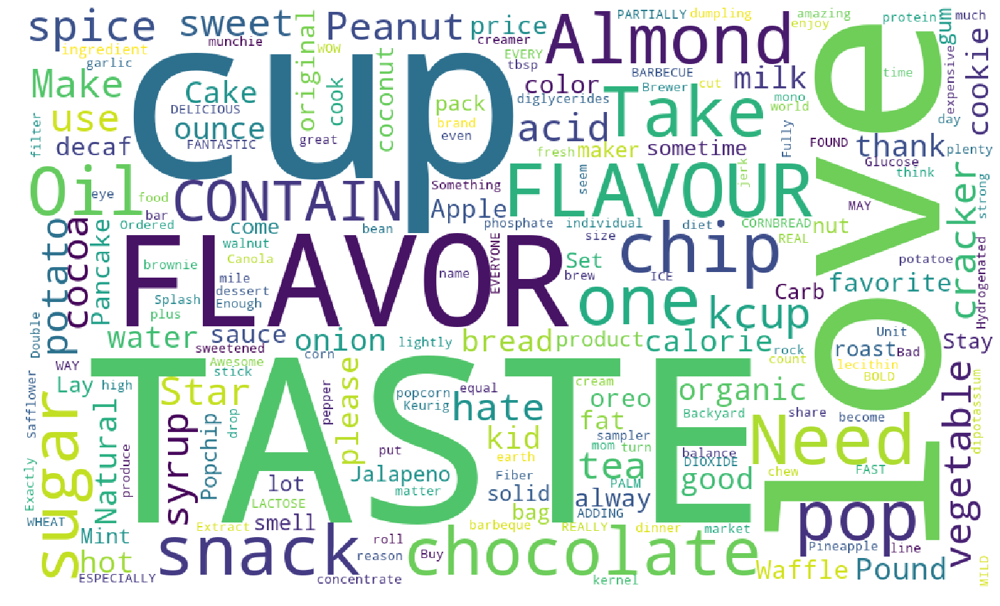

In [110]:
showWordCloud(cluster2)


The most frequently occuring word here seems to be "cup", "flavour" and "taste". This cluster seems to be related to beverages and tea snacks.

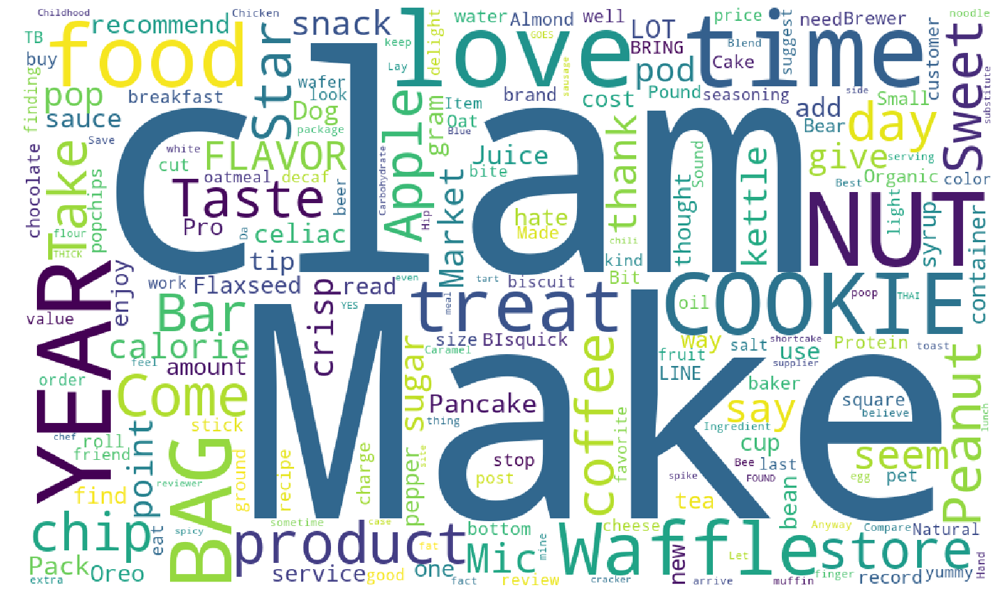

In [113]:
showWordCloud(cluster3)


The most frequently occuring word here seems to be "clam", "make" and "year". This cluster seems to be related to nuts and sweet items.

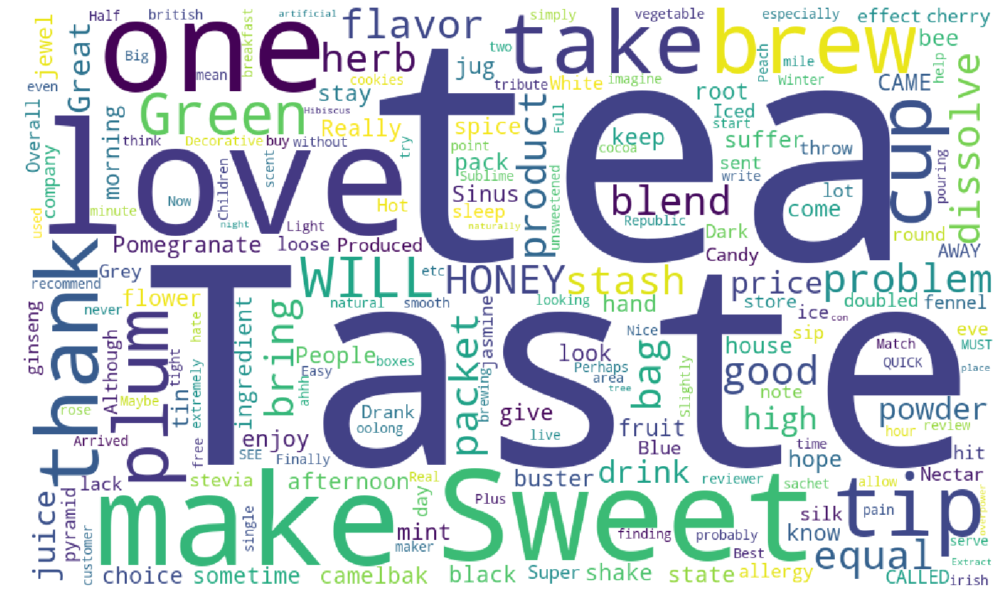

In [111]:
showWordCloud(cluster4)


The most frequently occuring word here seems to be "tea", "taste" and "love". This cluster seems to be related to tea.

## [5.3] DBSCAN Clustering

### [5.3.1] Applying DBSCAN on AVG W2V,<font color='red'> SET 3</font>

In [125]:
# Funtion to return the nearest square distance between the points in matrix
def n_neigh_distance(n_points,n_array):
    distance_matrix = []
    for point in n_array:
        dist = np.sort(np.sum((n_array - point)**2,axis=1),axis=None)
        distance_matrix.append(dist[n_points])
    return np.sqrt(np.array(distance_matrix))

In [126]:
sc = StandardScaler()
data_w2vec = sc.fit_transform(kmeans_w2vec_data)
# Calculating distances of point of nearest neighbour
min_pts = 2*preprocessed_reviews.shape[1]
nearest_distance = n_neigh_distance(min_pts,kmeans_w2vec_data)
# Sorting the distance so that it will help to find the best eps in the plot by giving a curve like plot
distance = np.sort(nearest_distance)

# genereting all possible point in range of the reviews
total_reviews = data_w2vec.shape[0]
data_points = []
for i in range(total_reviews):
    data_points.append(i)

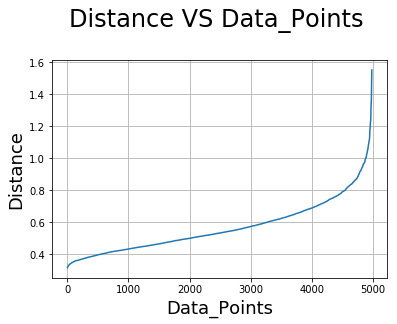

In [127]:
# Draw Distance VS Data_Points plot
plt.plot(data_points, distance)
plt.xlabel('Data_Points',size=18)
plt.ylabel('Distance',size=18)
plt.title('Distance VS Data_Points \n',size=24)
plt.grid()
plt.show()

In [128]:
dbscan_w2vec = DBSCAN(0.8, min_samples=min_pts, n_jobs=-1).fit(kmeans_w2vec_data)

In [129]:
# findind the clusters i the model
cluster = set(dbscan_w2vec.labels_)
cluster

{-1, 0}

In [130]:
n_clusters = 1

In [131]:
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = dbscan_w2vec.labels_.shape[0]
cluster1 = []
noise = []
for i in range(total_number_reviews):
    label = dbscan_w2vec.labels_[i]
    if label == -1:
        noise.append(all_rev[i])
    else :
        cluster1.append(all_rev[i]) 
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews as Noise : ",len(noise))

Total no. of reviews in Cluster 1 :  4890
Total no. of reviews as Noise :  96


### [5.3.2] Wordclouds of clusters obtained after applying DBSCAN on AVG W2V<font color='red'> SET 3</font>

In [132]:
# Please write all the code with proper documentation

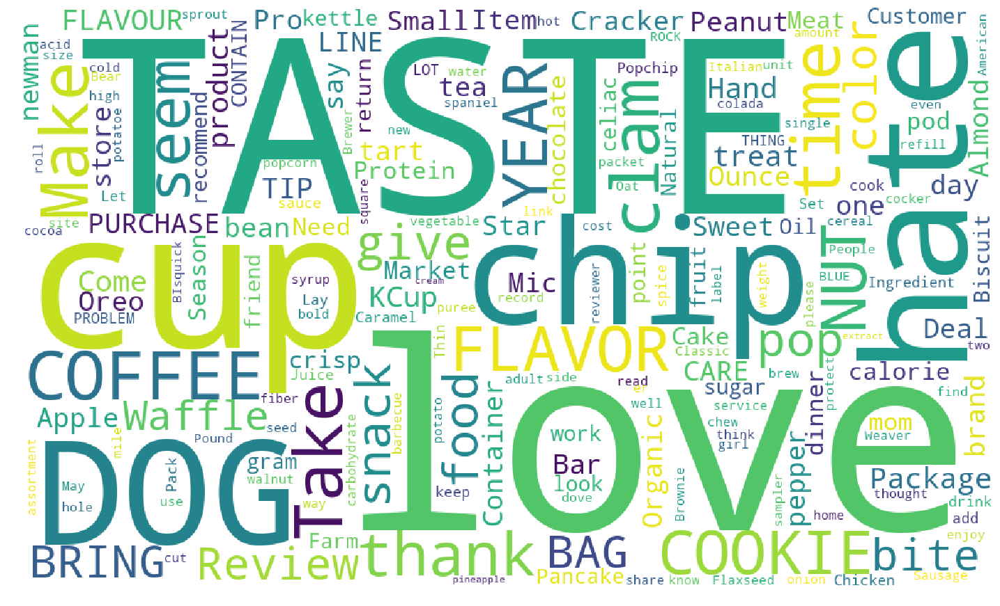

In [133]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "taste", "love" and "dog". This cluster seems to be related tall food items.

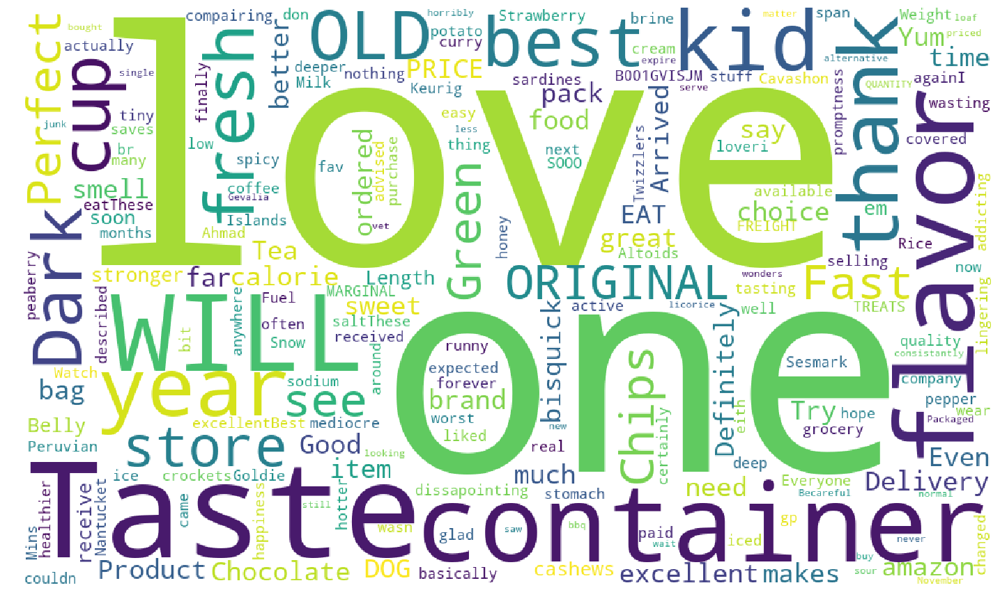

In [134]:
showWordCloud(noise)


The most frequently occuring word here seems to be "love", "one" and "taste". This cluster seems to be related to adjectives rather than actual food items.

### [5.3.3] Applying DBSCAN on TFIDF W2V,<font color='red'> SET 4</font>

In [135]:
sc = StandardScaler()
data_tfidf = sc.fit_transform(tfidf_sent_vectors_kmeans)
# Calculating distances of point of nearest neighbour
min_pts = 2*preprocessed_reviews.shape[1]
nearest_distance = n_neigh_distance(min_pts,tfidf_sent_vectors_kmeans)
# Sorting the distance so that it will help to find the best eps in the plot by giving a curve like plot
distance = np.sort(nearest_distance)

# genereting all possible point in range of the reviews
total_reviews = data_tfidf.shape[0]
data_points = []
for i in range(total_reviews):
    data_points.append(i)

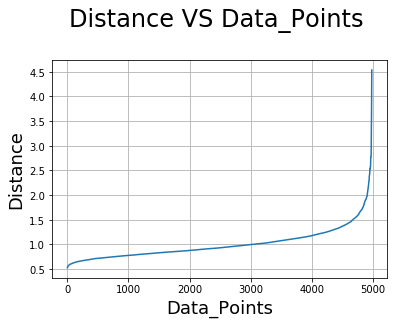

In [136]:
# Draw Distance VS Data_Points plot
plt.plot(data_points, distance)
plt.xlabel('Data_Points',size=18)
plt.ylabel('Distance',size=18)
plt.title('Distance VS Data_Points \n',size=24)
plt.grid()
plt.show()

In [137]:
dbscan_tfidf_w2vec  = DBSCAN(1.5, min_samples=min_pts, n_jobs=-1).fit(tfidf_sent_vectors_kmeans)

In [138]:
# findind the clusters i the model
cluster = set(dbscan_tfidf_w2vec .labels_)
cluster

{-1, 0}

In [139]:
n_clusters = 1

In [140]:
# Storing all reviews according to their cluster
all_rev = preprocessed_reviews['Text'].values
total_number_reviews = dbscan_tfidf_w2vec.labels_.shape[0]
cluster1 = []
noise = []
for i in range(total_number_reviews):
    label = dbscan_tfidf_w2vec.labels_[i]
    if label == -1:
        noise.append(all_rev[i])
    else :
        cluster1.append(all_rev[i]) 
print("Total no. of reviews in Cluster 1 : ",len(cluster1))
print("Total no. of reviews as Noise : ",len(noise))

Total no. of reviews in Cluster 1 :  4915
Total no. of reviews as Noise :  71


### [5.3.4] Wordclouds of clusters obtained after applying DBSCAN on TFIDF W2V<font color='red'> SET 4</font>

In [141]:
# Please write all the code with proper documentation

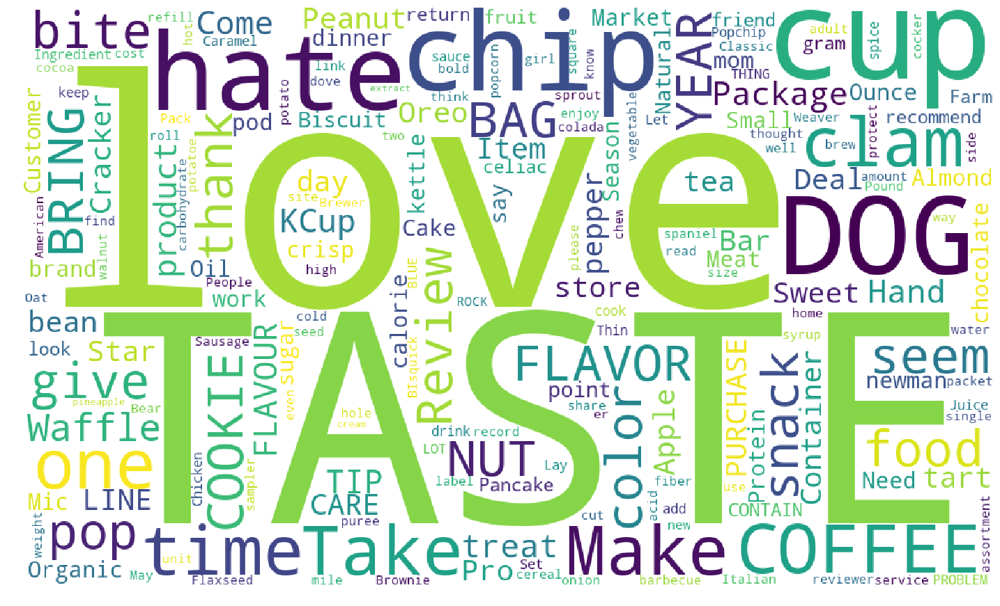

In [142]:
showWordCloud(cluster1)


The most frequently occuring word here seems to be "taste", "love" and "dog". This cluster seems to be related tall food items.

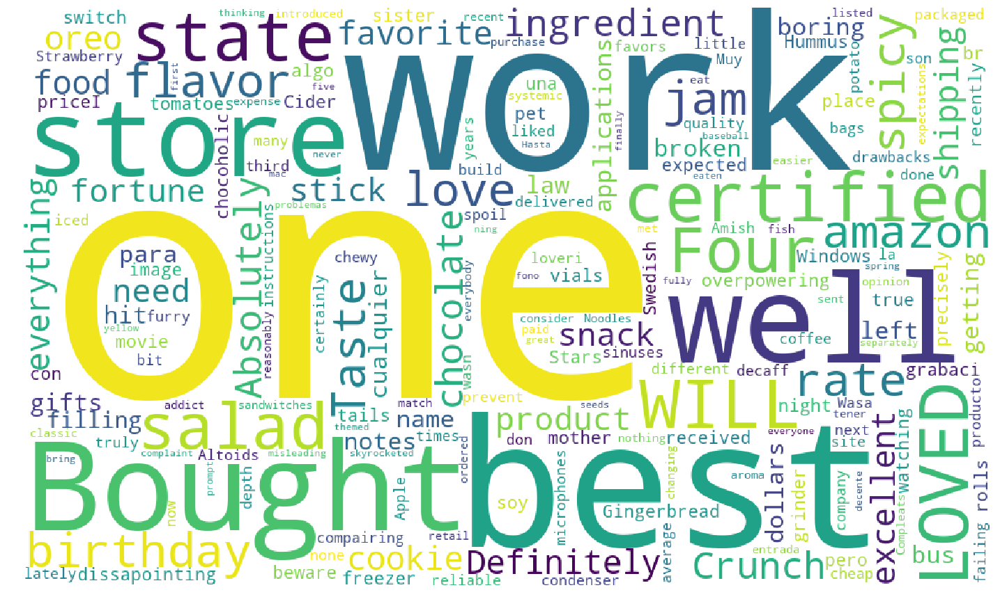

In [143]:
showWordCloud(noise)


In [ ]:
The most frequently occuring word here seems to be "best", "one" and "work". This cluster seems to be related to adjectives rather than actual food items.

# [6] Conclusions

# 6.1) K-Means Clustering

In [162]:
#importing library
from prettytable import PrettyTable
x = PrettyTable()

#adding Field names
x.field_names = ["SL No.","Vectorizer","Clustering","Best Cluster"]

# adding row to table
x.add_row(["1","BOW","KMEANS",7])
x.add_row(["2","TF-IDF","KMEANS",7])
x.add_row(["3","AVG-W2VEC","KMEANS",7])
x.add_row(["4","TFIDF-W2VEC","KMEANS",7])

#printing the table
print(x)

+--------+-------------+------------+--------------+
| SL No. |  Vectorizer | Clustering | Best Cluster |
+--------+-------------+------------+--------------+
|   1    |     BOW     |   KMEANS   |      7       |
|   2    |    TF-IDF   |   KMEANS   |      7       |
|   3    |  AVG-W2VEC  |   KMEANS   |      7       |
|   4    | TFIDF-W2VEC |   KMEANS   |      7       |
+--------+-------------+------------+--------------+


# 6.2) Agglomerative Clustering

In [163]:
#importing library
from prettytable import PrettyTable
x = PrettyTable()

#adding Field names
x.field_names = ["SL No.","Vectorizer","Clustering","Clusters"]

# adding row to table
x.add_row(["1","AVG-W2VEC","Agglometric",4])
x.add_row(["2","TFIDF-W2VEC","Agglometric",4])

#printing the table
print(x)

+--------+-------------+-------------+----------+
| SL No. |  Vectorizer |  Clustering | Clusters |
+--------+-------------+-------------+----------+
|   1    |  AVG-W2VEC  | Agglometric |    4     |
|   2    | TFIDF-W2VEC | Agglometric |    4     |
+--------+-------------+-------------+----------+


# 6.3) DBSCAN Clustering

In [146]:
#importing library
from prettytable import PrettyTable
x = PrettyTable()

#adding Field names
x.field_names = ["SL No.","Vectorizer","Clustering","Best EPS"]

# adding row to table
x.add_row(["1","AVG-W2VEC","DBSCAN",0.8])
x.add_row(["2","TFIDF-W2VEC","DBSCAN",1.5])

#printing the table
print(x)

+--------+-------------+------------+----------+
| SL No. |  Vectorizer | Clustering | Best EPS |
+--------+-------------+------------+----------+
|   1    |  AVG-W2VEC  |   DBSCAN   |   0.8    |
|   2    | TFIDF-W2VEC |   DBSCAN   |   1.5    |
+--------+-------------+------------+----------+


1) Applied  K-means, agglomerative and DBSCAN clustering on Amazon fine foods data set.
2) In the case of agglomerative, we tried 2 and 4 clusters with 4 clusters performing better at differentiating different food  items as observed from the workcloud.
3) We found the best EPS for DBSCAN using elbow method.